# Miscellaneous Scripts

Consists of scripts used for <b>Assignment 4</b> and <b>failed attempts</b> referenced in the report

## Assignment 4 Progress

Focused on model collapse prevention for specific digit generation, generator performance was abysmal given "D-G imbalance"

### Distill

Epoch 1/10


2025-04-08 21:43:41.164656: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2
2025-04-08 21:43:41.164684: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-04-08 21:43:41.164689: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-04-08 21:43:41.164709: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-04-08 21:43:41.164720: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2025-04-08 21:43:41.491099: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


469/469 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.6365 - loss: 1.3429
Epoch 2/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.8996 - loss: 0.3667
Epoch 3/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9166 - loss: 0.2967
Epoch 4/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9270 - loss: 0.2629
Epoch 5/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.9341 - loss: 0.2392
Epoch 6/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9392 - loss: 0.2205
Epoch 7/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9436 - loss: 0.2045
Epoch 8/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9478 - loss: 0.1909
Epoch 9/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9512 - loss: 0.1791
Epoch 10/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9542 - loss: 0.1686

Generation 1/5
Control Acc: 0.965, Single-Step Acc: 0.965
Indep. Control: 0.122, Indep. Single: 0.138
Pretrained Control: 0.101, Pretrained Single: 0

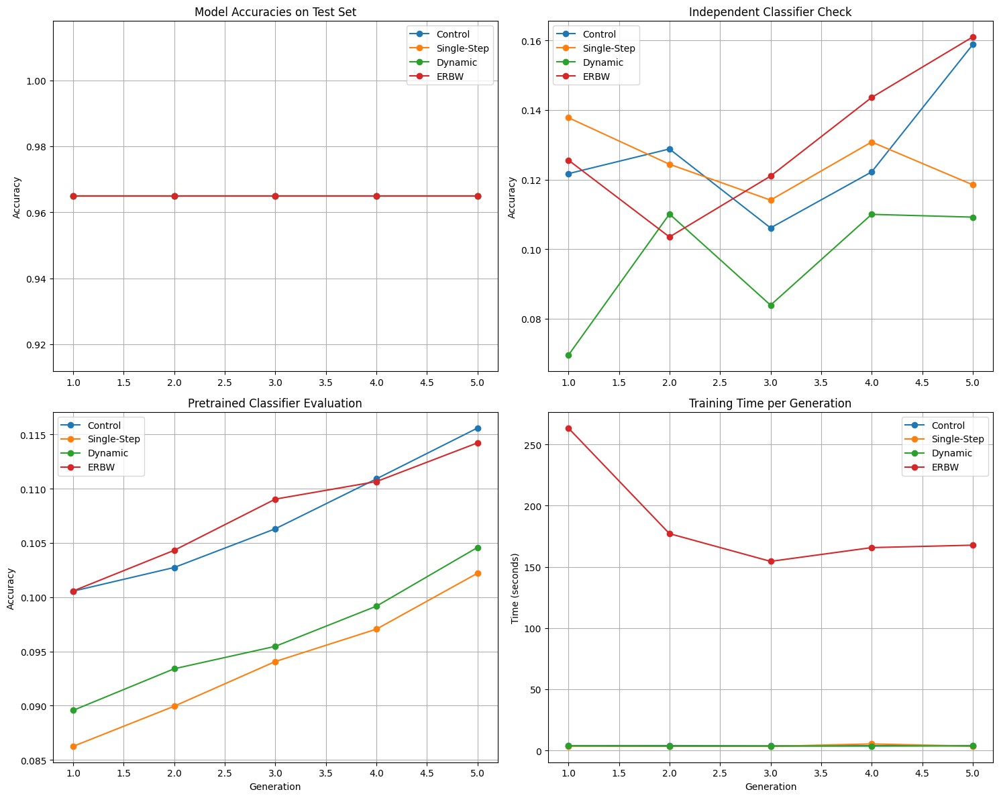

In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Input, Dense, Reshape, Conv2DTranspose, Conv2D, Flatten, LeakyReLU, ReLU, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.datasets import mnist
from tensorflow.keras.optimizers import Adam
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kurtosis
import time

# Set random seeds
np.random.seed(42)
tf.random.set_seed(42)

# Load MNIST data
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = (x_train.astype('float32') / 127.5) - 1
x_train = np.expand_dims(x_train, axis=-1)
x_test = (x_test.astype('float32') / 127.5) - 1
x_test = np.expand_dims(x_test, axis=-1)

# Constants
latent_dim = 50
num_classes = 10
batch_size = 128
epochs_per_generation = 20
generations = 5

# ------------------------------
# Model Definitions
# ------------------------------

# Simplified Generator model
def build_generator():
    noise_input = Input(shape=(latent_dim,))
    label_input = Input(shape=(num_classes,))
    merged = Concatenate()([noise_input, label_input])
    x = Dense(7 * 7 * 32, activation='relu')(merged)
    x = Reshape((7, 7, 32))(x)
    x = Conv2DTranspose(32, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2DTranspose(1, 4, strides=2, activation='tanh', padding='same')(x)
    return Model([noise_input, label_input], x, name='generator')

# Simplified Classifier model
def build_classifier():
    img_input = Input((28, 28, 1))
    x = Conv2D(32, 3, strides=2, padding='same')(img_input)
    x = LeakyReLU(0.2)(x)
    x = Flatten()(x)
    x = Dense(32, activation='relu')(x)
    output = Dense(num_classes, activation='softmax')(x)
    model = Model(img_input, output, name='classifier')
    model.compile(optimizer=Adam(1e-4),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

# ------------------------------
# Pre-train main classifier
# ------------------------------
pretrained_classifier = build_classifier()
pretrained_classifier.fit(x_train, y_train, epochs=10, batch_size=batch_size, verbose=1)

# ------------------------------
# Helper functions
# ------------------------------

# Generate synthetic samples
def generate_synthetic_samples(n, generator):
    noise = np.random.randn(n, latent_dim)
    labels = np.random.randint(0, num_classes, n)
    labels_onehot = tf.keras.utils.to_categorical(labels, num_classes)
    imgs = generator.predict([noise, labels_onehot], verbose=0)
    return imgs, labels

# Independent classifier evaluation
def independent_classifier_check(synth_imgs, synth_labels):
    clf = build_classifier()
    clf.fit(synth_imgs, synth_labels, epochs=1, batch_size=batch_size, verbose=0)
    acc = clf.evaluate(x_test, y_test, verbose=0)[1]
    return acc

# Pretrained classifier evaluation on generated data
def pretrained_classifier_check(synth_imgs, synth_labels):
    acc = pretrained_classifier.evaluate(synth_imgs, synth_labels, verbose=0)[1]
    return acc

# ------------------------------
# Training models (compartmentalized)
# ------------------------------

# Train Control Model
def train_control_model(generator, teacher_classifier):
    # Generate synthetic images
    synthetic_images, synthetic_labels = generate_synthetic_samples(len(x_train), generator)
    
    # No classifier training here - teacher model remains fixed
    
    # Generator training loop - using teacher classifier for guidance
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = teacher_classifier(gen_imgs, training=False)  # Keep teacher fixed
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synthetic_images, synthetic_labels

# Train Single-Step Weighting Model
def train_single_step_model(generator, teacher_classifier, real_ratio=0.7):
    # Generate synthetic images
    synthetic_images, synthetic_labels = generate_synthetic_samples(len(x_train), generator)

    # No classifier training here - teacher model remains fixed
    
    # Generator training loop - using teacher classifier
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = teacher_classifier(gen_imgs, training=False)  # Keep teacher fixed
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synthetic_images, synthetic_labels

# Dynamic weighting based on kurtosis
def train_dynamic_model(generator, teacher_classifier, target_kurtosis=1.0):
    # Generate synthetic samples
    synth_imgs, synth_labels = generate_synthetic_samples(len(x_train), generator)

    # Compute current kurtosis
    synth_kurtosis = kurtosis(synth_imgs.flatten())

    # No classifier training here - teacher model remains fixed
    
    # Generator training - using teacher classifier
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = teacher_classifier(gen_imgs, training=False)  # Keep teacher fixed
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synth_imgs, synth_labels

# Revised ERBW class with cosine similarity and effortful retrieval
class ERBWBufferCosine:
    def __init__(self, real_data, real_labels):
        self.real_data = real_data.reshape(len(real_data), -1)
        self.real_labels = real_labels
        self.timestamps = np.zeros(len(real_data))  # τ(x)

    def update_timestamps(self, closest_real_indices):
        current_time = np.max(self.timestamps) + 1
        self.timestamps[closest_real_indices] = current_time

    def get_sample_weights(self, generated_imgs):
        gen_flat = generated_imgs.reshape(len(generated_imgs), -1)
        sim_matrix = cosine_similarity(gen_flat, self.real_data)

        # For each generated image, find most similar real image index
        closest_real_indices = np.argmax(sim_matrix, axis=1)
        retrieval_times = self.timestamps[closest_real_indices]

        # Higher τ(x) = less recently retrieved = more likely to sample
        weights = tf.nn.softmax(retrieval_times).numpy()
        return weights, closest_real_indices

# ERBW training loop with cosine similarity
def train_erbw_model(generator, teacher_classifier, buffer, retrieval_ratio=0.5):
    # Generate synthetic data
    synth_imgs, synth_labels = generate_synthetic_samples(len(x_train), generator)
    
    # Get sample weights based on retrieval history
    weights, closest_indices = buffer.get_sample_weights(synth_imgs)
    
    # Update timestamps of retrieved samples
    buffer.update_timestamps(closest_indices)
    
    # Use weights to select a mix of examples with preference to less frequently retrieved
    n_samples = len(x_train)
    sample_indices = np.random.choice(
        np.arange(len(synth_imgs)), 
        size=n_samples,
        p=weights / np.sum(weights)
    )
    
    # Select weighted synthetic samples
    weighted_imgs = synth_imgs[sample_indices]
    weighted_labels = synth_labels[sample_indices]
    
    # No classifier training here - teacher model remains fixed
    
    # Generator training - using teacher classifier
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = teacher_classifier(gen_imgs, training=False)  # Keep teacher fixed
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return weighted_imgs, weighted_labels

# ------------------------------
# Main evaluation loop
# ------------------------------
control_acc, single_step_acc = [], []
independent_control_acc, independent_single_acc = [], []
pretrained_control_acc, pretrained_single_acc = [], []
control_times, single_step_times = [], []
dynamic_times, erbw_times = [], []

# Initialize generators
control_gen = build_generator()
single_gen = build_generator()
dynamic_gen = build_generator()
erbw_gen = build_generator()

# Initialize a single teacher classifier for distillation
teacher_classifier = build_classifier()
teacher_classifier.fit(x_train, y_train, epochs=20, batch_size=batch_size, verbose=0)

# Initialize ERBW buffer
erbw_buffer = ERBWBufferCosine(x_train, y_train)

dynamic_acc, erbw_acc = [], []
independent_dynamic_acc, independent_erbw_acc = [], []
pretrained_dynamic_acc, pretrained_erbw_acc = [], []

for gen in range(generations):
    print(f"\nGeneration {gen+1}/{generations}")

    # Control Model
    start_time = time.time()
    ctrl_imgs, ctrl_labels = train_control_model(control_gen, teacher_classifier)
    control_times.append(time.time() - start_time)
    # Evaluate on test set
    ctrl_real_acc = teacher_classifier.evaluate(x_test, y_test, verbose=0)[1]
    control_acc.append(ctrl_real_acc)

    ind_ctrl_acc = independent_classifier_check(ctrl_imgs, ctrl_labels)
    independent_control_acc.append(ind_ctrl_acc)

    pretrain_ctrl_acc = pretrained_classifier_check(ctrl_imgs, ctrl_labels)
    pretrained_control_acc.append(pretrain_ctrl_acc)

    # Single-Step Model
    start_time = time.time()
    ss_imgs, ss_labels = train_single_step_model(single_gen, teacher_classifier)
    single_step_times.append(time.time() - start_time)
    ss_real_acc = teacher_classifier.evaluate(x_test, y_test, verbose=0)[1]
    single_step_acc.append(ss_real_acc)

    ind_ss_acc = independent_classifier_check(ss_imgs, ss_labels)
    independent_single_acc.append(ind_ss_acc)

    pretrain_ss_acc = pretrained_classifier_check(ss_imgs, ss_labels)
    pretrained_single_acc.append(pretrain_ss_acc)

    # Dynamic Step Weighting Model
    start_time = time.time()
    dyn_imgs, dyn_labels = train_dynamic_model(dynamic_gen, teacher_classifier)
    dynamic_times.append(time.time() - start_time)
    dynamic_acc.append(teacher_classifier.evaluate(x_test, y_test, verbose=0)[1])
    independent_dynamic_acc.append(independent_classifier_check(dyn_imgs, dyn_labels))
    pretrained_dynamic_acc.append(pretrained_classifier_check(dyn_imgs, dyn_labels))

    # ERBW Model
    start_time = time.time()
    erbw_imgs, erbw_labels = train_erbw_model(erbw_gen, teacher_classifier, erbw_buffer)
    erbw_times.append(time.time() - start_time)
    erbw_acc.append(teacher_classifier.evaluate(x_test, y_test, verbose=0)[1])
    independent_erbw_acc.append(independent_classifier_check(erbw_imgs, erbw_labels))
    pretrained_erbw_acc.append(pretrained_classifier_check(erbw_imgs, erbw_labels))

    # Print all timing information
    print(f"Control Acc: {ctrl_real_acc:.3f}, Single-Step Acc: {ss_real_acc:.3f}")
    print(f"Indep. Control: {ind_ctrl_acc:.3f}, Indep. Single: {ind_ss_acc:.3f}")
    print(f"Pretrained Control: {pretrain_ctrl_acc:.3f}, Pretrained Single: {pretrain_ss_acc:.3f}")
    print(f"Dynamic Accuracy: {dynamic_acc[-1]:.3f}, ERBW Accuracy: {erbw_acc[-1]:.3f}")
    print(f"Indep. Dynamic: {independent_dynamic_acc[-1]:.3f}, Indep. ERBW: {independent_erbw_acc[-1]:.3f}")
    print(f"Pretrained Dynamic: {pretrained_dynamic_acc[-1]:.3f}, Pretrained ERBW: {pretrained_erbw_acc[-1]:.3f}")
    print(f"Times - Control: {control_times[-1]:.2f}s, Single-Step: {single_step_times[-1]:.2f}s")
    print(f"Times - Dynamic: {dynamic_times[-1]:.2f}s, ERBW: {erbw_times[-1]:.2f}s")

# ------------------------------
# Plotting results
# ------------------------------
plt.figure(figsize=(15, 12))
gens = np.arange(1, generations+1)

# Create 2x2 grid of subplots
plt.subplot(2, 2, 1)
plt.plot(gens, control_acc, '-o', label='Control')
plt.plot(gens, single_step_acc, '-o', label='Single-Step')
plt.plot(gens, dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, erbw_acc, '-o', label='ERBW')
plt.title('Model Accuracies on Test Set')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(gens, independent_control_acc, '-o', label='Control')
plt.plot(gens, independent_single_acc, '-o', label='Single-Step')
plt.plot(gens, independent_dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, independent_erbw_acc, '-o', label='ERBW')
plt.title('Independent Classifier Check')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 3)
plt.plot(gens, pretrained_control_acc, '-o', label='Control')
plt.plot(gens, pretrained_single_acc, '-o', label='Single-Step')
plt.plot(gens, pretrained_dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, pretrained_erbw_acc, '-o', label='ERBW')
plt.title('Pretrained Classifier Evaluation')
plt.xlabel('Generation')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(gens, control_times, '-o', label='Control')
plt.plot(gens, single_step_times, '-o', label='Single-Step')
plt.plot(gens, dynamic_times, '-o', label='Dynamic')
plt.plot(gens, erbw_times, '-o', label='ERBW')
plt.title('Training Time per Generation')
plt.xlabel('Generation')
plt.ylabel('Time (seconds)')
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()


### Coevolve

Epoch 1/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - accuracy: 0.5750 - loss: 1.4231
Epoch 2/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9004 - loss: 0.3652
Epoch 3/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9205 - loss: 0.2868
Epoch 4/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9323 - loss: 0.2504
Epoch 5/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9390 - loss: 0.2260
Epoch 6/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9439 - loss: 0.2073
Epoch 7/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9475 - loss: 0.1921
Epoch 8/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9509 - loss: 0.1794
Epoch 9/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9541 - loss: 0.1683
Epoch 10/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9577 - loss: 0.1585

Generation 1/5
Control Acc: 0.114, Single-Step Acc: 0.950
Indep. Control: 0.114, Indep. Single: 0.166
Pretrained Control: 0.097, Pretraine

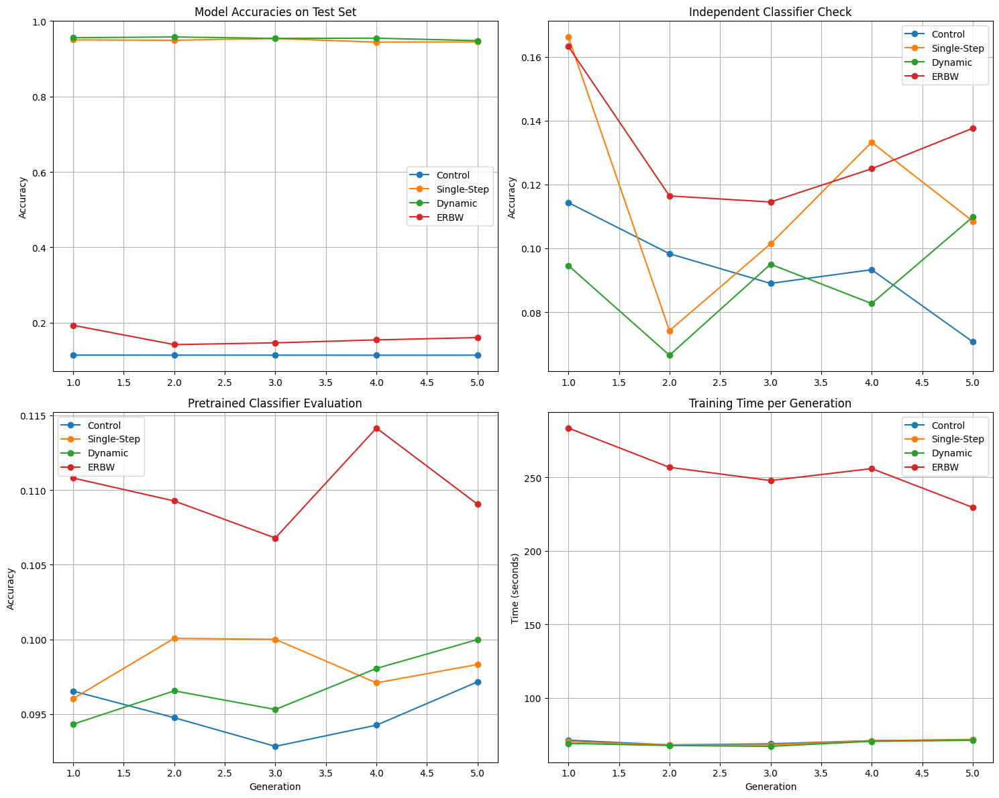

In [22]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Input, Dense, Reshape, Conv2DTranspose, Conv2D, Flatten, LeakyReLU, ReLU, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.datasets import mnist
from tensorflow.keras.optimizers import Adam
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kurtosis
import time  # Add this at the top with other imports

# Set random seeds
np.random.seed(42)
tf.random.set_seed(42)

# Load MNIST data
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = (x_train.astype('float32') / 127.5) - x_train = np.expand_dims(x_train, axis=-1)
x_test = (x_test.astype('float32') / 127.5) - 1
x_test = np.expand_dims(x_test, axis=-1)

# Constants
latent_dim = 50
num_classes = 10
batch_size = 128
epochs_per_generation = 20
generations = 5

# ------------------------------
# Model Definitions
# ------------------------------

# Simplified Generator model
def build_generator():
    noise_input = Input(shape=(latent_dim,))
    label_input = Input(shape=(num_classes,))
    merged = Concatenate()([noise_input, label_input])
    x = Dense(7 * 7 * 32, activation='relu')(merged)
    x = Reshape((7, 7, 32))(x)
    x = Conv2DTranspose(32, 4, strides=2, padding='same')(x)
    x = ReLU()(x)
    x = Conv2DTranspose(1, 4, strides=2, activation='tanh', padding='same')(x)
    return Model([noise_input, label_input], x, name='generator')

# Simplified Classifier model
def build_classifier():
    img_input = Input((28, 28, 1))
    x = Conv2D(32, 3, strides=2, padding='same')(img_input)
    x = LeakyReLU(0.2)(x)
    x = Flatten()(x)
    x = Dense(32, activation='relu')(x)
    output = Dense(num_classes, activation='softmax')(x)
    model = Model(img_input, output, name='classifier')
    model.compile(optimizer=Adam(1e-4),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

# ------------------------------
# Pre-train main classifier
# ------------------------------
pretrained_classifier = build_classifier()
pretrained_classifier.fit(x_train, y_train, epochs=10, batch_size=batch_size, verbose=1)

# ------------------------------
# Helper functions
# ------------------------------

# Generate synthetic samples
def generate_synthetic_samples(n, generator):
    noise = np.random.randn(n, latent_dim)
    labels = np.random.randint(0, num_classes, n)
    labels_onehot = tf.keras.utils.to_categorical(labels, num_classes)
    imgs = generator.predict([noise, labels_onehot], verbose=0)
    return imgs, labels

# Independent classifier evaluation
def independent_classifier_check(synth_imgs, synth_labels):
    clf = build_classifier()
    clf.fit(synth_imgs, synth_labels, epochs=5, batch_size=batch_size, verbose=0)
    acc = clf.evaluate(x_test, y_test, verbose=0)[1]
    return acc

# Pretrained classifier evaluation on generated data
def pretrained_classifier_check(synth_imgs, synth_labels):
    acc = pretrained_classifier.evaluate(synth_imgs, synth_labels, verbose=0)[1]
    return acc

# ------------------------------
# Training models (compartmentalized)
# ------------------------------

# Train Control Model
def train_control_model(generator, classifier):
    synthetic_images, synthetic_labels = generate_synthetic_samples(len(x_train), generator)
    classifier.fit(synthetic_images, synthetic_labels, epochs=epochs_per_generation, batch_size=batch_size, verbose=0)

    # Generator training loop
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = classifier(gen_imgs, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synthetic_images, synthetic_labels

# Train Single-Step Weighting Model
def train_single_step_model(generator, classifier, real_ratio=0.7):
    synthetic_images, synthetic_labels = generate_synthetic_samples(len(x_train), generator)

    n_real = int(len(x_train) * real_ratio)
    mixed_imgs = np.concatenate([x_train[:n_real], synthetic_images[n_real:]])
    mixed_labels = np.concatenate([y_train[:n_real], synthetic_labels[n_real:]])
    classifier.fit(mixed_imgs, mixed_labels, epochs=epochs_per_generation, batch_size=batch_size, verbose=0)

    # Generator training loop
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = classifier(gen_imgs, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synthetic_images, synthetic_labels

# Dynamic weighting based on kurtosis
def train_dynamic_model(generator, classifier, target_kurtosis=1.0):
    # Generate synthetic samples
    synth_imgs, synth_labels = generate_synthetic_samples(len(x_train), generator)

    # Compute current kurtosis
    synth_kurtosis = kurtosis(synth_imgs.flatten())

    # Dynamically adjust mixing ratio based on kurtosis difference
    kurtosis_diff = abs(target_kurtosis - synth_kurtosis)
    real_ratio = np.clip(0.5 + 0.5 * kurtosis_diff, 0.2, 0.8)  # Adjust within sensible range [0.2, 0.8]

    # Mix real and synthetic samples dynamically
    n_real = int(len(x_train) * real_ratio)
    mixed_imgs = np.concatenate([x_train[:n_real], synth_imgs[n_real:]])
    mixed_labels = np.concatenate([y_train[:n_real], synth_labels[n_real:]])
    classifier.fit(mixed_imgs, mixed_labels, epochs=epochs_per_generation, batch_size=batch_size, verbose=0)

    # Generator training
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = classifier(gen_imgs, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return synth_imgs, synth_labels

# Revised ERBW class with cosine similarity and effortful retrieval
class ERBWBufferCosine:
    def __init__(self, real_data, real_labels):
        self.real_data = real_data.reshape(len(real_data), -1)
        self.real_labels = real_labels
        self.timestamps = np.zeros(len(real_data))  # τ(x)

    def update_timestamps(self, closest_real_indices):
        current_time = np.max(self.timestamps) + 1
        self.timestamps[closest_real_indices] = current_time

    def get_sample_weights(self, generated_imgs):
        gen_flat = generated_imgs.reshape(len(generated_imgs), -1)
        sim_matrix = cosine_similarity(gen_flat, self.real_data)

        # For each generated image, find most similar real image index
        closest_real_indices = np.argmax(sim_matrix, axis=1)
        retrieval_times = self.timestamps[closest_real_indices]

        # Higher τ(x) = less recently retrieved = more likely to sample
        weights = tf.nn.softmax(retrieval_times).numpy()
        return weights, closest_real_indices

# ERBW training loop with cosine similarity
def train_erbw_model(generator, classifier, buffer, retrieval_ratio=0.5):
    # Generate synthetic data
    synth_imgs, synth_labels = generate_synthetic_samples(len(x_train), generator)
    
    # Get sample weights based on retrieval history
    weights, closest_indices = buffer.get_sample_weights(synth_imgs)
    
    # Update timestamps of retrieved samples
    buffer.update_timestamps(closest_indices)
    
    # Use weights to select a mix of examples with preference to less frequently retrieved
    n_samples = len(x_train)
    sample_indices = np.random.choice(
        np.arange(len(synth_imgs)), 
        size=n_samples,
        p=weights / np.sum(weights)
    )
    
    # Select weighted synthetic samples
    weighted_imgs = synth_imgs[sample_indices]
    weighted_labels = synth_labels[sample_indices]
    
    # Train classifier on selected data
    classifier.fit(weighted_imgs, weighted_labels, epochs=epochs_per_generation, batch_size=batch_size, verbose=0)

    # Generator training loop - uses own classifier
    gen_optimizer = Adam(1e-4)
    for _ in range(epochs_per_generation):
        noise = np.random.randn(batch_size, latent_dim)
        fake_labels = np.random.randint(0, num_classes, batch_size)
        fake_labels_onehot = tf.keras.utils.to_categorical(fake_labels, num_classes)
        with tf.GradientTape() as tape:
            gen_imgs = generator([noise, fake_labels_onehot], training=True)
            preds = classifier(gen_imgs, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(fake_labels, preds)
        grads = tape.gradient(loss, generator.trainable_variables)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_variables))

    return weighted_imgs, weighted_labels


# ------------------------------
# Main evaluation loop
# ------------------------------
control_acc, single_step_acc = [], []
independent_control_acc, independent_single_acc = [], []
pretrained_control_acc, pretrained_single_acc = [], []
control_times, single_step_times = [], []
dynamic_times, erbw_times = [], []

# Initialize models separately
control_gen = build_generator()
control_clf = build_classifier()
single_gen = build_generator()
single_clf = build_classifier()

# Initialize Dynamic and ERBW models
dynamic_gen, dynamic_clf = build_generator(), build_classifier()
dynamic_clf.fit(x_train, y_train, epochs=20, batch_size=batch_size, verbose=0)

erbw_gen, erbw_clf = build_generator(), build_classifier()
erbw_clf.fit(x_train, y_train, epochs=20, batch_size=batch_size, verbose=0)
# Replace ERBWBuffer with ERBWBufferCosine
erbw_buffer = ERBWBufferCosine(x_train, y_train)

dynamic_acc, erbw_acc = [], []
independent_dynamic_acc, independent_erbw_acc = [], []
pretrained_dynamic_acc, pretrained_erbw_acc = [], []

# Pre-train classifiers
control_clf.fit(x_train, y_train, epochs=20, batch_size=batch_size, verbose=0)
single_clf.fit(x_train, y_train, epochs=20, batch_size=batch_size, verbose=0)

for gen in range(generations):
    print(f"\nGeneration {gen+1}/{generations}")

    # Control Model
    start_time = time.time()
    ctrl_imgs, ctrl_labels = train_control_model(control_gen, control_clf)
    control_times.append(time.time() - start_time)
    ctrl_real_acc = control_clf.evaluate(x_test, y_test, verbose=0)[1]
    control_acc.append(ctrl_real_acc)

    ind_ctrl_acc = independent_classifier_check(ctrl_imgs, ctrl_labels)
    independent_control_acc.append(ind_ctrl_acc)

    pretrain_ctrl_acc = pretrained_classifier_check(ctrl_imgs, ctrl_labels)
    pretrained_control_acc.append(pretrain_ctrl_acc)

    # Single-Step Model
    start_time = time.time()
    ss_imgs, ss_labels = train_single_step_model(single_gen, single_clf)
    single_step_times.append(time.time() - start_time)
    ss_real_acc = single_clf.evaluate(x_test, y_test, verbose=0)[1]
    single_step_acc.append(ss_real_acc)

    ind_ss_acc = independent_classifier_check(ss_imgs, ss_labels)
    independent_single_acc.append(ind_ss_acc)

    pretrain_ss_acc = pretrained_classifier_check(ss_imgs, ss_labels)
    pretrained_single_acc.append(pretrain_ss_acc)

    # Dynamic Step Weighting Model
    start_time = time.time()
    dyn_imgs, dyn_labels = train_dynamic_model(dynamic_gen, dynamic_clf)
    dynamic_times.append(time.time() - start_time)
    dynamic_acc.append(dynamic_clf.evaluate(x_test, y_test, verbose=0)[1])
    independent_dynamic_acc.append(independent_classifier_check(dyn_imgs, dyn_labels))
    pretrained_dynamic_acc.append(pretrained_classifier_check(dyn_imgs, dyn_labels))

    # ERBW Model
    start_time = time.time()
    erbw_imgs, erbw_labels = train_erbw_model(erbw_gen, erbw_clf, erbw_buffer)
    erbw_times.append(time.time() - start_time)
    erbw_acc.append(erbw_clf.evaluate(x_test, y_test, verbose=0)[1])
    independent_erbw_acc.append(independent_classifier_check(erbw_imgs, erbw_labels))
    pretrained_erbw_acc.append(pretrained_classifier_check(erbw_imgs, erbw_labels))

    # Print all timing information
    print(f"Control Acc: {ctrl_real_acc:.3f}, Single-Step Acc: {ss_real_acc:.3f}")
    print(f"Indep. Control: {ind_ctrl_acc:.3f}, Indep. Single: {ind_ss_acc:.3f}")
    print(f"Pretrained Control: {pretrain_ctrl_acc:.3f}, Pretrained Single: {pretrain_ss_acc:.3f}")
    print(f"Dynamic Accuracy: {dynamic_acc[-1]:.3f}, ERBW Accuracy: {erbw_acc[-1]:.3f}")
    print(f"Indep. Dynamic: {independent_dynamic_acc[-1]:.3f}, Indep. ERBW: {independent_erbw_acc[-1]:.3f}")
    print(f"Pretrained Dynamic: {pretrained_dynamic_acc[-1]:.3f}, Pretrained ERBW: {pretrained_erbw_acc[-1]:.3f}")
    print(f"Times - Control: {control_times[-1]:.2f}s, Single-Step: {single_step_times[-1]:.2f}s")
    print(f"Times - Dynamic: {dynamic_times[-1]:.2f}s, ERBW: {erbw_times[-1]:.2f}s")

# ------------------------------
# Plotting results
# ------------------------------
plt.figure(figsize=(15, 12))
gens = np.arange(1, generations+1)

# Create 2x2 grid of subplots
plt.subplot(2, 2, 1)
plt.plot(gens, control_acc, '-o', label='Control')
plt.plot(gens, single_step_acc, '-o', label='Single-Step')
plt.plot(gens, dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, erbw_acc, '-o', label='ERBW')
plt.title('Model Accuracies on Test Set')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(gens, independent_control_acc, '-o', label='Control')
plt.plot(gens, independent_single_acc, '-o', label='Single-Step')
plt.plot(gens, independent_dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, independent_erbw_acc, '-o', label='ERBW')
plt.title('Independent Classifier Check')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 3)
plt.plot(gens, pretrained_control_acc, '-o', label='Control')
plt.plot(gens, pretrained_single_acc, '-o', label='Single-Step')
plt.plot(gens, pretrained_dynamic_acc, '-o', label='Dynamic')
plt.plot(gens, pretrained_erbw_acc, '-o', label='ERBW')
plt.title('Pretrained Classifier Evaluation')
plt.xlabel('Generation')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(gens, control_times, '-o', label='Control')
plt.plot(gens, single_step_times, '-o', label='Single-Step')
plt.plot(gens, dynamic_times, '-o', label='Dynamic')
plt.plot(gens, erbw_times, '-o', label='ERBW')
plt.title('Training Time per Generation')
plt.xlabel('Generation')
plt.ylabel('Time (seconds)')
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()


## Failed Attempts

I include a selected set of failed attempts to create better generator architectures before deciding on the current DCGAN/Discriminator architectures

Generator sanity checks from Assignment 4 (absolute gibberish)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


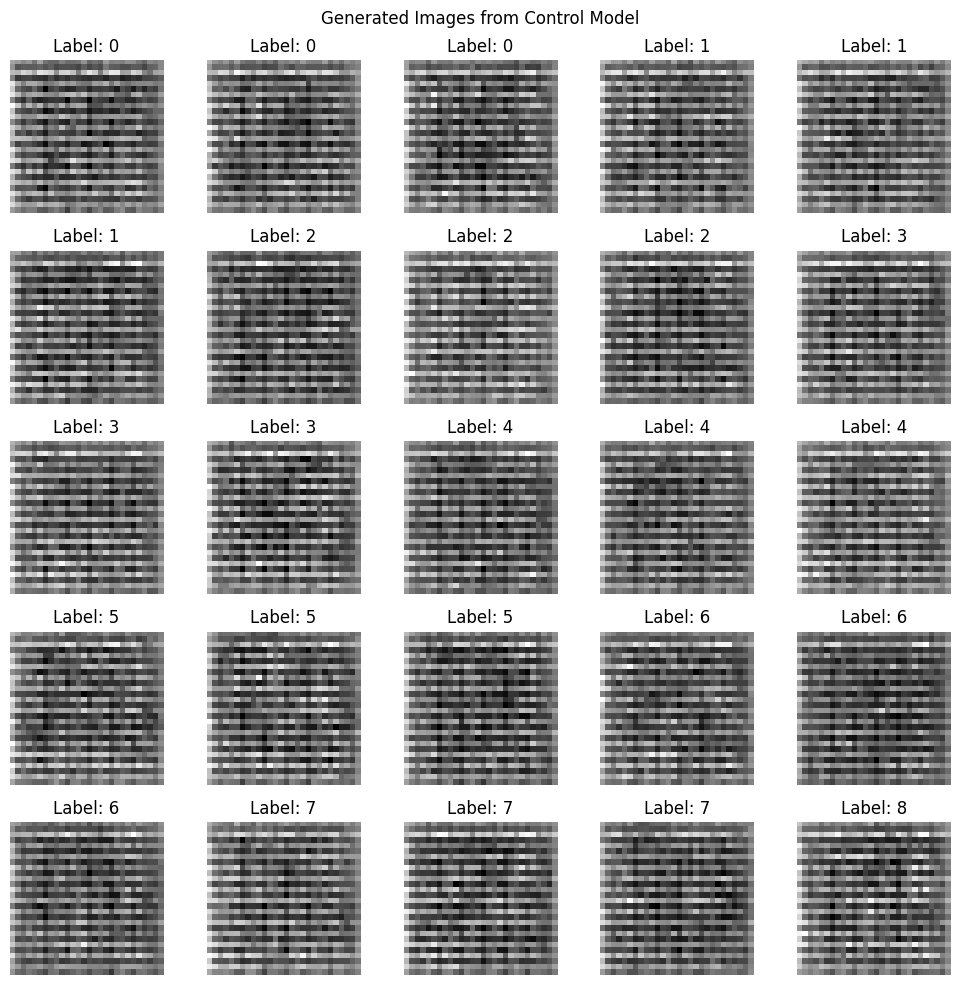

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


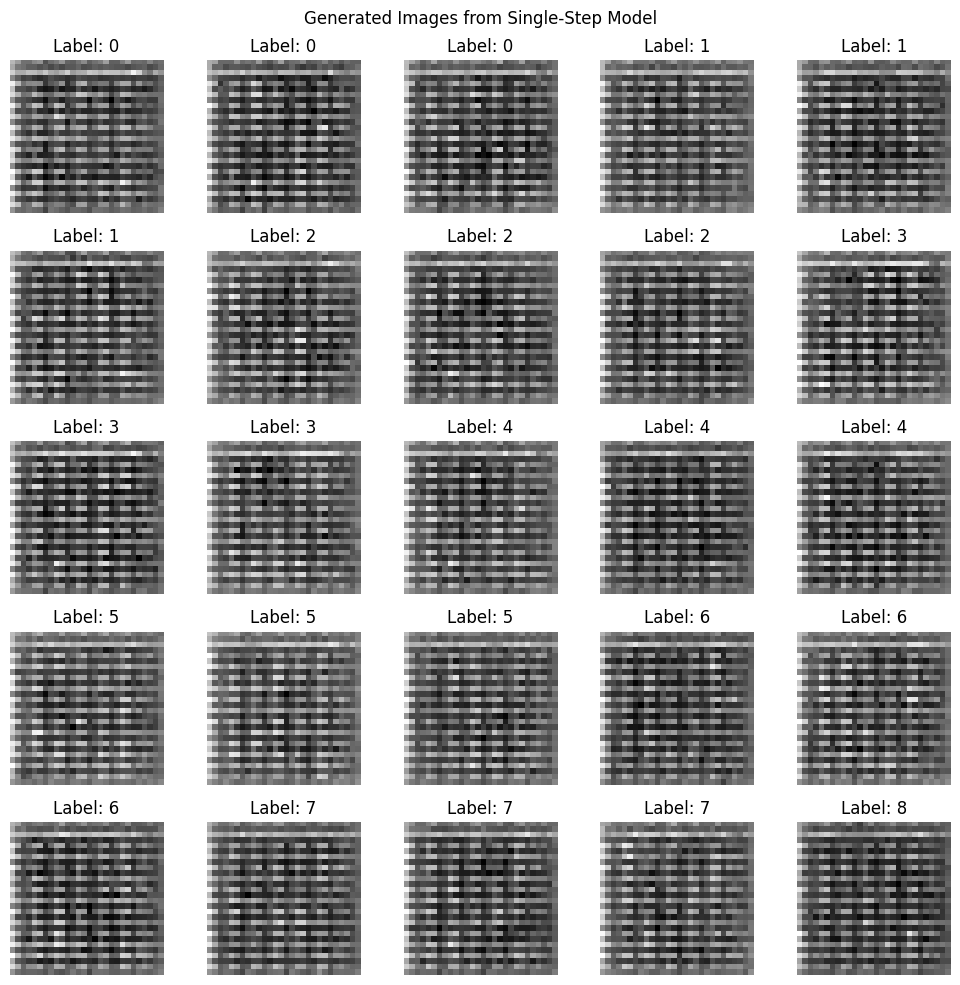

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


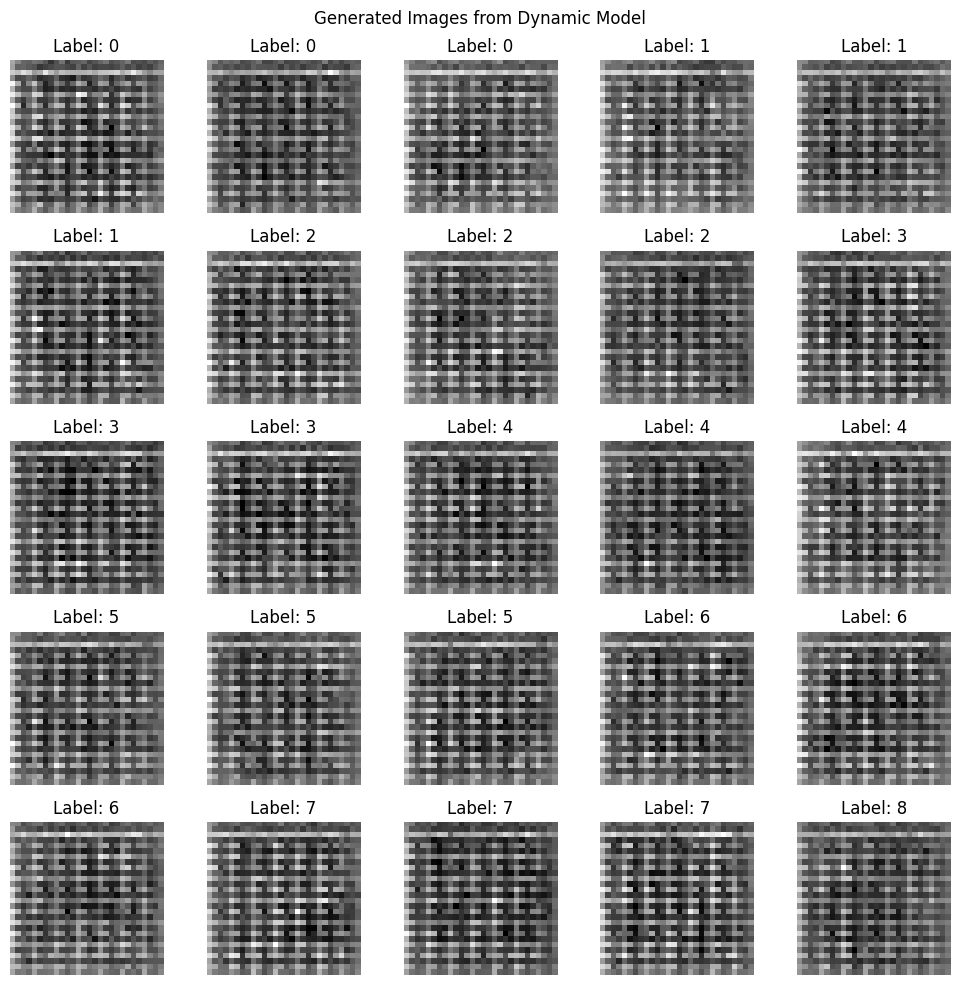

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


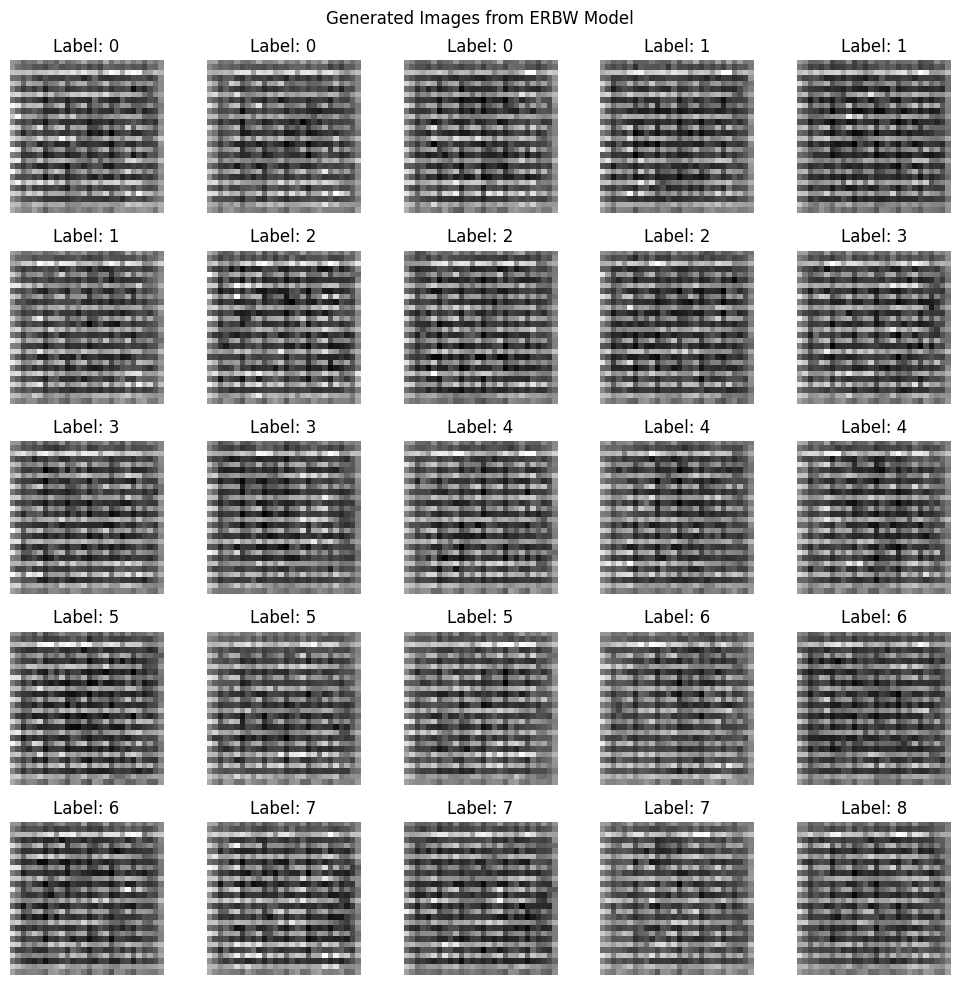

In [4]:
# Add this after your existing imports
import matplotlib.pyplot as plt

def plot_generated_images(generator, name, n_examples=25):
    # Generate images
    noise = np.random.randn(n_examples, latent_dim)
    # Generate labels 0-9 repeated as needed
    labels = np.repeat(np.arange(10), (n_examples+9)//10)[:n_examples]
    labels_onehot = tf.keras.utils.to_categorical(labels, num_classes)
    
    # Generate images
    images = generator.predict([noise, labels_onehot])
    
    # Create figure
    plt.figure(figsize=(10, 10))
    for i in range(n_examples):
        plt.subplot(5, 5, i+1)
        plt.imshow(images[i, :, :, 0], cmap='gray')
        plt.title(f'Label: {labels[i]}')
        plt.axis('off')
    plt.suptitle(f'Generated Images from {name} Model')
    plt.tight_layout()
    plt.show()

# Plot images from each generator
plot_generated_images(control_gen, "Control")
plot_generated_images(single_gen, "Single-Step")
plot_generated_images(dynamic_gen, "Dynamic")
plot_generated_images(erbw_gen, "ERBW")

Attempted a new architecture inspired by TensorFlow's official tutorial, not much better

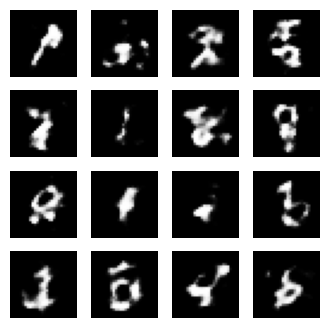

/var/folders/cn/pp6d0qpj065b2rnbz70v6x7c0000gn/T/ipykernel_13047/2689132049.py:182: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/var/folders/cn/pp6d0qpj065b2rnbz70v6x7c0000gn/T/ipykernel_13047/2689132049.py:184: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


ModuleNotFoundError: No module named 'tensorflow_docs'

In [15]:
import tensorflow as tf
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

BUFFER_SIZE = 60000
BATCH_SIZE = 256

# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 28, 28, 1)

    return model

generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
     
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)


train(train_dataset, EPOCHS)

checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

display_image(EPOCHS)

anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)
     
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)



Qualitatively explored how a classifier trained on MNIST would fare in classifying generated images following the TensorFlow tutorial

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


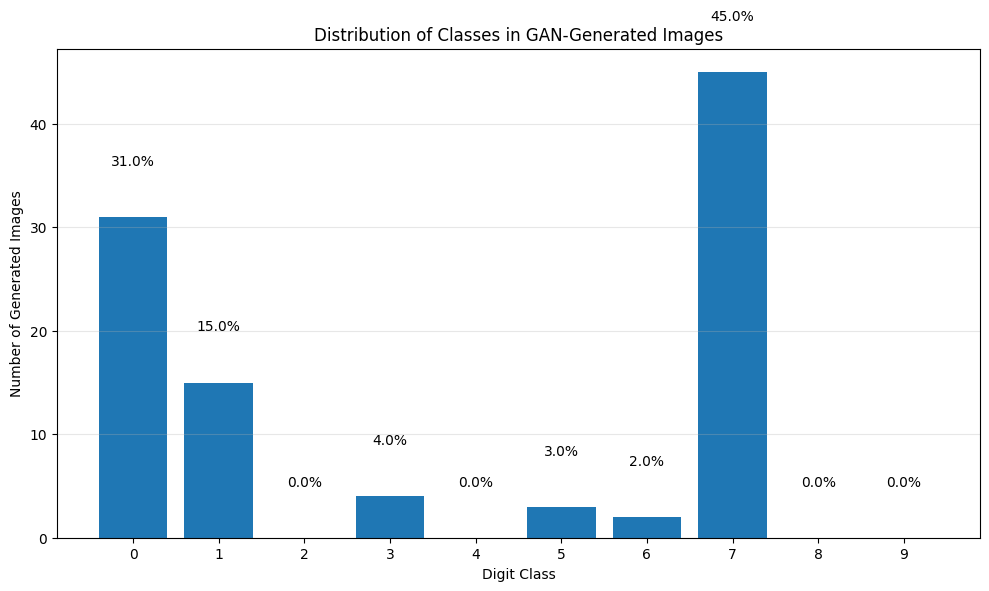

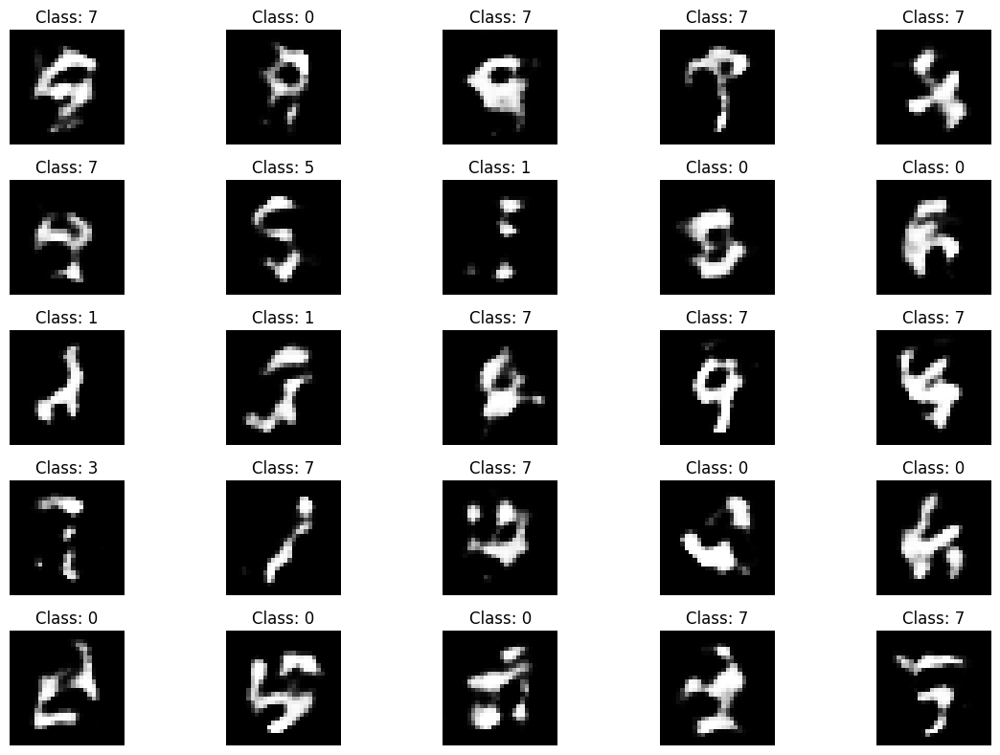

Distribution of generated classes:
Class 0: 31 images (31.00%)
Class 1: 15 images (15.00%)
Class 2: 0 images (0.00%)
Class 3: 4 images (4.00%)
Class 4: 0 images (0.00%)
Class 5: 3 images (3.00%)
Class 6: 2 images (2.00%)
Class 7: 45 images (45.00%)
Class 8: 0 images (0.00%)
Class 9: 0 images (0.00%)


ValueError: Argument `output` must have rank (ndim) `target.ndim - 1`. Received: target.shape=(None, 10), output.shape=(None, 10)

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# Generate a batch of synthetic images using the already loaded generator
num_samples = 100
noise = tf.random.normal([num_samples, noise_dim])
generated_images = generator(noise, training=False)

# Convert images from [-1, 1] range to [0, 1] for the classifier
normalized_images = (generated_images * 0.5 + 0.5)

# Get predictions from the pretrained classifier (already loaded)
predictions = pretrained_classifier.predict(normalized_images)
predicted_classes = np.argmax(predictions, axis=1)

# Count occurrences of each class
class_counts = np.bincount(predicted_classes, minlength=10)  # Assuming MNIST with 10 classes

# Create a plot showing distribution of classes
plt.figure(figsize=(10, 6))
plt.bar(range(10), class_counts)
plt.xlabel('Digit Class')
plt.ylabel('Number of Generated Images')
plt.title('Distribution of Classes in GAN-Generated Images')
plt.xticks(range(10))
plt.grid(axis='y', alpha=0.3)

# Add percentage labels above each bar
total = class_counts.sum()
for i, count in enumerate(class_counts):
    percentage = 100 * count / total
    plt.text(i, count + 5, f'{percentage:.1f}%', ha='center')

plt.tight_layout()
plt.savefig('gan_class_distribution.png')
plt.show()

# Show example images with their predicted classes
plt.figure(figsize=(12, 8))
for i in range(25):  # Show 25 examples
    plt.subplot(5, 5, i+1)
    plt.imshow(generated_images[i, :, :, 0] * 0.5 + 0.5, cmap='gray')
    plt.title(f'Class: {predicted_classes[i]}')
    plt.axis('off')

plt.tight_layout()
plt.savefig('gan_examples_with_classes.png')
plt.show()

# Calculate distribution metrics
original_distribution = np.ones(10) / 10  # Uniform distribution (ideal)
generated_distribution = class_counts / total

print("Distribution of generated classes:")
for i in range(10):
    print(f"Class {i}: {class_counts[i]} images ({generated_distribution[i]*100:.2f}%)")

# Use the utility function from scripts.ipynb if available
dummy_labels = tf.keras.utils.to_categorical(predicted_classes, num_classes=10)
acc = pretrained_classifier_check(normalized_images, dummy_labels)
print(f"Classifier confidence (accuracy with predicted labels): {acc:.4f}")

# Create a confusion matrix-like visualization to show classifier confidence
plt.figure(figsize=(8, 6))
confidence_per_class = []
for i in range(10):
    # Get confidence scores for images predicted as class i
    class_indices = np.where(predicted_classes == i)[0]
    if len(class_indices) > 0:
        # Get the confidence (probability) for the predicted class
        conf = np.mean([predictions[j, i] for j in class_indices])
        confidence_per_class.append(conf)
    else:
        confidence_per_class.append(0)

plt.bar(range(10), confidence_per_class)
plt.xlabel('Digit Class')
plt.ylabel('Average Confidence Score')
plt.title('Classifier Confidence per Generated Class')
plt.xticks(range(10))
plt.ylim(0, 1)
plt.grid(axis='y', alpha=0.3)
plt.savefig('gan_classifier_confidence.png')
plt.show()

Attempted to repurpose the DCGAN method from Radford et. al (2015) to produce digits rather than real v. fake, could not reasonably overcome the D-G imbalance problem

In [ ]:
"""
Conditional DCGAN on MNIST: defines generator and discriminator conditioned on digit labels,
trains from scratch, and provides a script to generate images of a specific digit.
Uses 32×32 inputs/outputs so that the discriminator ends with a scalar per sample.
"""
import os
import random
import argparse

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# --------------------------- Hyperparameters ---------------------------
dataset_root = './data'
batch_size    = 64
image_size    = 32      # using 32x32 images for both G and D
nc            = 1       # number of channels (grayscale)
nz            = 100     # latent vector size
embed_size    = 50      # embedding dim for labels
ngf           = 64      # generator feature map size
ndf           = 64      # discriminator feature map size
num_epochs    = 25
lr            = 0.0002
beta1         = 0.5
num_classes   = 10
ngpu          = 1       # number of GPUs
device        = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
output_dir    = './output'
weights_dir   = './weights'

os.makedirs(output_dir, exist_ok=True)
os.makedirs(weights_dir, exist_ok=True)

# -------------------------- Reproducibility ---------------------------
manualSeed = random.randint(1, 10000)
print("Random Seed:", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

# ----------------------------- DataLoader -----------------------------
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])
dataset = dset.MNIST(root=dataset_root, download=True, transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=2)

# --------------------------- Weight Init ------------------------------
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# ------------------------ Model Definitions ---------------------------
class ConditionalGenerator(nn.Module):
    def __init__(self, ngpu, nz, ngf, nc, num_classes, embed_size):
        super(ConditionalGenerator, self).__init__()
        self.ngpu = ngpu
        self.label_emb = nn.Embedding(num_classes, embed_size)
        self.init_size = image_size // 8  # 32/8 = 4
        self.l1 = nn.Linear(nz + embed_size, ngf * 8 * self.init_size * self.init_size)
        self.conv_blocks = nn.Sequential(
            nn.BatchNorm2d(ngf * 8),
            nn.Upsample(scale_factor=2),  # 4 -> 8
            nn.Conv2d(ngf * 8, ngf * 4, 3, stride=1, padding=1),
            nn.BatchNorm2d(ngf * 4), nn.ReLU(True),
            nn.Upsample(scale_factor=2),  # 8 -> 16
            nn.Conv2d(ngf * 4, ngf * 2, 3, stride=1, padding=1),
            nn.BatchNorm2d(ngf * 2), nn.ReLU(True),
            nn.Upsample(scale_factor=2),  # 16 -> 32
            nn.Conv2d(ngf * 2, ngf, 3, stride=1, padding=1),
            nn.BatchNorm2d(ngf),    nn.ReLU(True),
            nn.Conv2d(ngf, nc, 3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        label_vec = self.label_emb(labels)
        x = torch.cat([noise, label_vec], dim=1)
        out = self.l1(x)
        out = out.view(out.size(0), ngf * 8, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img  # (batch, nc, 32, 32)

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ngpu, nc, ndf, num_classes, embed_size):
        super(ConditionalDiscriminator, self).__init__()
        self.ngpu = ngpu
        # embed labels to a full 32x32 map
        self.label_emb = nn.Embedding(num_classes, nc * image_size * image_size)
        self.main = nn.Sequential(
            # input has 2 channels: image + label map
            nn.Conv2d(nc * 2, ndf, 4, 2, 1, bias=False),  # 32 -> 16
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False), # 16 -> 8
            nn.BatchNorm2d(ndf * 2), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False), # 8 -> 4
            nn.BatchNorm2d(ndf * 4), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),  # 4 -> 1
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        batch_size = img.size(0)
        label_map = self.label_emb(labels).view(batch_size, nc, image_size, image_size)
        d_in = torch.cat([img, label_map], dim=1)
        out = self.main(d_in)
        return out.view(batch_size)  # (batch,)

# ------------------------- Initialize Models -------------------------
netG = ConditionalGenerator(ngpu, nz, ngf, nc, num_classes, embed_size).to(device)
netG.apply(weights_init)
netD = ConditionalDiscriminator(ngpu, nc, ndf, num_classes, embed_size).to(device)
netD.apply(weights_init)

# --------------------------- Loss & Optimizers -----------------------
criterion = nn.BCELoss()
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# ---------------------------- Training Loop -------------------------
fixed_noise = torch.randn(batch_size, nz, device=device)
fixed_labels = torch.arange(num_classes, device=device).repeat(batch_size // num_classes + 1)[:batch_size]
real_label = 1.
fake_label = 0.

print("Starting Training...")
for epoch in range(num_epochs):
    for i, (data, labels) in enumerate(dataloader):
        netD.zero_grad()
        real_imgs = data.to(device)
        labels = labels.to(device)
        b_size = real_imgs.size(0)
        valid = torch.full((b_size,), real_label, device=device)
        out_real = netD(real_imgs, labels)
        errD_real = criterion(out_real, valid)
        errD_real.backward()

        noise = torch.randn(b_size, nz, device=device)
        fake_imgs = netG(noise, labels)
        fake = torch.full((b_size,), fake_label, device=device)
        out_fake = netD(fake_imgs.detach(), labels)
        errD_fake = criterion(out_fake, fake)
        errD_fake.backward()
        optimizerD.step()

        netG.zero_grad()
        valid.fill_(real_label)
        out_fake2 = netD(fake_imgs, labels)
        errG = criterion(out_fake2, valid)
        errG.backward()
        optimizerG.step()

        if i % 100 == 0:
            print(f"[{epoch}/{num_epochs}][{i}/{len(dataloader)}]"
                  f" Loss_D: {(errD_real+errD_fake):.4f} Loss_G: {errG:.4f}")
            vutils.save_image(real_imgs, os.path.join(output_dir, 'real_samples.png'), normalize=True)
            fake_fixed = netG(fixed_noise, fixed_labels)
            vutils.save_image(fake_fixed, os.path.join(output_dir, f'fake_samples_epoch_{epoch:03d}.png'), normalize=True)

    torch.save(netG.state_dict(), os.path.join(weights_dir, f'cond_netG_epoch_{epoch}.pth'))
    torch.save(netD.state_dict(), os.path.join(weights_dir, f'cond_netD_epoch_{epoch}.pth'))

# -------------------------- Generation Script ------------------------
if __name__ == '__main__':
    parser = argparse.ArgumentParser()
    parser.add_argument('--digit', type=int, default=0, help='digit to generate [0-9]')
    parser.add_argument('--num',   type=int, default=64, help='number of images')
    parser.add_argument('--epoch', type=int, default=num_epochs-1, help='checkpoint epoch')
    args = parser.parse_args()

    ckpt = os.path.join(weights_dir, f'cond_netG_epoch_{args.epoch}.pth')
    netG.load_state_dict(torch.load(ckpt, map_location=device))
    netG.eval()

    noise  = torch.randn(args.num, nz, device=device)
    labels = torch.full((args.num,), args.digit, dtype=torch.long, device=device)
    samples = netG(noise, labels)
    vutils.save_image(samples, os.path.join(output_dir, f'digit_{args.digit}_epoch_{args.epoch}.png'),
                      nrow=8, normalize=True)
    print(f"Saved {args.num} samples of digit {args.digit} to {output_dir}")


Random Seed: 3827
Starting Training...
[0/25][0/938] Loss_D: 1.4247 Loss_G: 2.0098
[0/25][100/938] Loss_D: 1.2551 Loss_G: 2.5499


KeyboardInterrupt: 

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.datasets import mnist
from skimage.transform import resize

# -----------------------------------------------------------------------------
# 1) Conditional Generator definition
# -----------------------------------------------------------------------------
class CondGenerator(nn.Module):
    def __init__(self, n_labels=10, nz=100, ngf=64, nc=1):
        super().__init__()
        self.label_emb = nn.Linear(n_labels, n_labels)
        self.main = nn.Sequential(
            # input is Z + label one-hot → (nz + n_labels) × 1 × 1
            nn.ConvTranspose2d(nz + n_labels, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8), nn.ReLU(True),
            # → (ngf*8)×4×4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4), nn.ReLU(True),
            # → (ngf*4)×8×8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2), nn.ReLU(True),
            # → (ngf*2)×16×16
            nn.ConvTranspose2d(ngf * 2, ngf,     4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),     nn.ReLU(True),
            # → ngf×32×32
            nn.ConvTranspose2d(ngf,     nc,      1, 1, 0, bias=False),
            nn.Tanh()
            # final: (nc)×32×32 in [-1,1]
        )

    def forward(self, noise, labels):
        # noise: (B, nz), labels: (B,) int
        B = noise.size(0)
        onehot = torch.zeros(B, self.label_emb.in_features, device=noise.device)
        onehot.scatter_(1, labels.unsqueeze(1), 1)
        le = self.label_emb(onehot).view(B, -1, 1, 1)
        z  = noise.view(B, -1, 1, 1)
        x = torch.cat([z, le], dim=1)
        return self.main(x)

# -----------------------------------------------------------------------------
# 2) Load pre-trained conditional GAN generator
# -----------------------------------------------------------------------------
print("Loading conditional GAN generator...")
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

nz = 100
n_labels = 10

G = CondGenerator(n_labels=n_labels, nz=nz).to(device)
G.load_state_dict(torch.load('weights/cganG_epoch_1.pth', map_location=device))
G.eval()
print("Generator loaded from weights/cganG_epoch_1.pth.")

# -----------------------------------------------------------------------------
# 3) Build & train a small TensorFlow MNIST classifier
# -----------------------------------------------------------------------------
print("Building and training MNIST classifier (TensorFlow)...")
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = x_train.reshape(-1,28,28,1).astype('float32')/255
x_test  = x_test.reshape(-1,28,28,1).astype('float32')/255
y_train = to_categorical(y_train, 10)
y_test  = to_categorical(y_test, 10)

classifier = Sequential([
    Conv2D(32, (3,3), activation='relu', input_shape=(28,28,1)),
    MaxPooling2D((2,2)),
    Conv2D(64, (3,3), activation='relu'),
    MaxPooling2D((2,2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(10, activation='softmax')
])
classifier.compile(loss='categorical_crossentropy',
                   optimizer='adam',
                   metrics=['accuracy'])

# train on subset for speed
subset_size = 10000
classifier.fit(x_train[:subset_size], y_train[:subset_size],
               batch_size=128, epochs=3, verbose=1,
               validation_data=(x_test, y_test))
print("Classifier trained.\n")

# -----------------------------------------------------------------------------
# 4) Generate conditional images
# -----------------------------------------------------------------------------
print("Sampling from GAN...")
num_images = 64
noise  = torch.randn(num_images, nz, device=device)
# sample random labels 0–9
labels = torch.randint(0, n_labels, (num_images,), device=device)
with torch.no_grad():
    gen = G(noise, labels).cpu()      # shape: (64, 1, 32, 32)

gen_np = gen.numpy()

# -----------------------------------------------------------------------------
# 5) Prepare for TF classifier: [B, H, W, C], resize to 28×28, normalize to [0,1]
# -----------------------------------------------------------------------------
# transpose to (B, H, W, C)
images_tf = np.transpose(gen_np, (0,2,3,1))
print("Raw generated shape:", images_tf.shape)

# resize if not 28×28
if images_tf.shape[1] != 28 or images_tf.shape[2] != 28:
    resized = []
    for img in images_tf:
        # skimage.resize preserves range; result still in [-1,1]
        r = resize(img, (28,28,1), anti_aliasing=True, preserve_range=True)
        resized.append(r)
    images_tf = np.stack(resized, axis=0)
    print("Resized to:", images_tf.shape)

# scale to [0,1]
images_tf = (images_tf + 1.0) / 2.0

# -----------------------------------------------------------------------------
# 6) Classify the generated digits
# -----------------------------------------------------------------------------
print("Classifying generated images...")
preds = classifier.predict(images_tf, verbose=0)
pred_classes = np.argmax(preds, axis=1)

# -----------------------------------------------------------------------------
# 7) Display & save results
# -----------------------------------------------------------------------------
plt.figure(figsize=(10,10))
plt.suptitle("Conditional GAN samples → classifier preds", fontsize=16)

for i in range(num_images):
    plt.subplot(8,8,i+1)
    plt.imshow(images_tf[i,:,:,0], cmap='gray')
    plt.title(str(pred_classes[i]), fontsize=8)
    plt.axis('off')

plt.tight_layout(rect=[0,0,1,0.96])
os.makedirs('output', exist_ok=True)
out_path = 'output/cgan_classifier_results.png'
plt.savefig(out_path)
plt.show()
print(f"\nSaved visualization to {out_path}")

# -----------------------------------------------------------------------------
# 8) Stats: distribution & average confidence
# -----------------------------------------------------------------------------
uniq, counts = np.unique(pred_classes, return_counts=True)
print("\nDistribution of predicted digits:")
for d,c in zip(uniq,counts):
    print(f"  Digit {d}: {c}/{num_images} ({c/num_images*100:.1f}%)")

conf_scores = np.max(preds, axis=1)
print(f"\nAverage classifier confidence: {conf_scores.mean():.3f}")


## Final Scripts!!

In [7]:
from __future__ import print_function
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

cudnn.benchmark = True

#set manual seed to a constant get a consistent output
manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

#loading the dataset
dataset = dset.MNIST(root='./data', download=True,
                       transform=transforms.Compose([
                           transforms.Resize(28),
                           transforms.ToTensor(),
                           transforms.Normalize((0.5,), (0.5,)),
                       ]))
#number of channels in image(since the image is grayscale the number of channels are 1)
nc=1

dataloader = torch.utils.data.DataLoader(dataset, batch_size=64,
                                         shuffle=True, num_workers=2)

#checking the availability of cuda devices
device = 'cpu'

# number of gpu's available
ngpu = 1
# input noise dimension
nz = 100
# number of generator filters
ngf = 64
#number of discriminator filters
ndf = 64

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    def __init__(self, ngpu, nc=1, nz=100, ngf=64):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(    ngf,      nc, kernel_size=1, stride=1, padding=2, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
        return output

netG = Generator(ngpu).to(device)
netG.apply(weights_init)
netG.load_state_dict(torch.load('weights/netG_epoch_99.pth', map_location=torch.device('cpu')))
print(netG)

class Discriminator(nn.Module):
    def __init__(self, ngpu, nc=1, ndf=64):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, 1, 4, 2, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
        return output.view(-1, 1).squeeze(1)

netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
netD.load_state_dict(torch.load('weights/netD_epoch_99.pth', map_location=torch.device('cpu')))
print(netD)

criterion = nn.BCELoss()

# setup optimizer
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.0
fake_label = 0.0

niter = 25

# Commented out IPython magic to ensure Python compatibility.
for epoch in range(niter):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        # train with real
        netD.zero_grad()
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)

        output = netD(real_cpu)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # train with fake
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach())
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label) 
        output = netD(fake)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
                  % (epoch, niter, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        if i % 100 == 0:
            vutils.save_image(real_cpu,'output/real_samples.png' ,normalize=True)
            fake = netG(fixed_noise)
            vutils.save_image(fake.detach(),'output/fake_samples_epoch_%03d.png' % (epoch), normalize=True)        
    torch.save(netG.state_dict(), 'weights/netG_epoch_%d.pth' % (epoch))
    torch.save(netD.state_dict(), 'weights/netD_epoch_%d.pth' % (epoch))

num_gpu = 1 if torch.cuda.is_available() else 0

# load the models

D = Discriminator(ngpu=1).eval()
G = Generator(ngpu=1).eval()

# load weights
D.load_state_dict(torch.load('weights/netD_epoch_99.pth', map_location=torch.device('cpu')))
G.load_state_dict(torch.load('weights/netG_epoch_99.pth', map_location=torch.device('cpu')))
if torch.cuda.is_available():
    D = D.cuda()
    G = G.cuda()

batch_size = 25
latent_size = 100

fixed_noise = torch.randn(batch_size, latent_size, 1, 1)
if torch.cuda.is_available():
    fixed_noise = fixed_noise.cuda()
fake_images = G(fixed_noise)


# z = torch.randn(batch_size, latent_size).cuda()
# z = Variable(z)
# fake_images = G(z)

fake_images_np = fake_images.cpu().detach().numpy()
fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
R, C = 5, 5
for i in range(batch_size):
    plt.subplot(R, C, i + 1)
    plt.imshow(fake_images_np[i], cmap='gray')
plt.show()

Random Seed:  872
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(1, 1), stride=(1, 1), padding=(2, 2), bias=False)
    (

KeyboardInterrupt: 

In [14]:
#!/usr/bin/env python3
"""
load_dcgan.py

Defines the original DCGAN Generator and Discriminator for MNIST,
and loads pretrained Ksuryateja/DCGAN-MNIST-pytorch weights.
"""

import os
import random
import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn

#------------------------------------------------------------------------------
# Hyperparameters & device
#------------------------------------------------------------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cudnn.benchmark = True

manual_seed = random.randint(1, 10000)
print("Random Seed:", manual_seed)
random.seed(manual_seed)
torch.manual_seed(manual_seed)

ngpu = 1       # number of GPUs available
nz   = 100     # latent vector size
ngf  = 64      # generator feature maps
ndf  = 64      # discriminator feature maps
nc   = 1       # number of channels (MNIST is grayscale)

weights_dir = "./weights"  # clone Ksuryateja repo here

#------------------------------------------------------------------------------
# Weight init (as in DCGAN paper)
#------------------------------------------------------------------------------
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

#------------------------------------------------------------------------------
# Generator (DCGAN)
#------------------------------------------------------------------------------
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input: Z latent vector (batch, nz, 1, 1)
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8), nn.ReLU(True),
            # state: (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4), nn.ReLU(True),
            # state: (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2), nn.ReLU(True),
            # state: (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf,     4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),     nn.ReLU(True),
            # state: (ngf) x 32 x 32
            # final conv to 28x28
            nn.ConvTranspose2d(ngf, nc, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        # input: (batch, nz, 1, 1)
        out = self.main(input)
        # center-crop to 28x28 if needed
        return out[:, :, :28, :28]

#------------------------------------------------------------------------------
# Discriminator (DCGAN)
#------------------------------------------------------------------------------
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input: (nc) x 28 x 28
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),  # 28->14
            nn.LeakyReLU(0.2, inplace=True),

            # state: (ndf) x 14 x 14
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),  # 14->7
            nn.BatchNorm2d(ndf * 2), nn.LeakyReLU(0.2, inplace=True),

            # state: (ndf*2) x 7 x 7
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),  # 7->3
            nn.BatchNorm2d(ndf * 4), nn.LeakyReLU(0.2, inplace=True),

            # state: (ndf*4) x 3 x 3
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),  # 3->0 (1x1)
            nn.Sigmoid()
        )

    def forward(self, input):
        # input: (batch, nc, 28, 28)
        out = self.main(input)
        return out.view(-1)

#------------------------------------------------------------------------------
# Instantiate & load weights
#------------------------------------------------------------------------------
# Generator
netG = Generator(ngpu).to(device)
netG.apply(weights_init)
g_path = os.path.join(weights_dir, "netG_epoch_99.pth")
netG.load_state_dict(torch.load(g_path, map_location=device))
netG.eval()
print(netG)

# Discriminator
netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
d_path = os.path.join(weights_dir, "netD_epoch_99.pth")
netD.load_state_dict(torch.load(d_path, map_location=device))
netD.eval()
print(netD)


Random Seed: 7221
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (13): Tanh()
  )


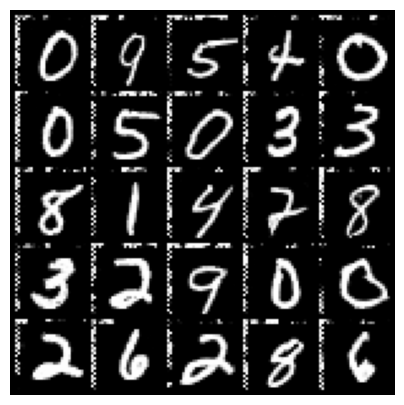

In [22]:
import torchvision.utils as vutils
import matplotlib.pyplot as plt

# ---- sample 25 random latent vectors ----
batch_size = 25
noise = torch.randn(batch_size, nz, 1, 1, device=device)

# ---- generate fake digits ----
with torch.no_grad():
    fake_imgs = netG(noise)

# ---- make a 5×5 grid and display ----
grid = vutils.make_grid(fake_imgs, nrow=5, normalize=True, scale_each=True)

plt.figure(figsize=(5,5))
plt.axis('off')
# permute CHW → HWC for matplotlib
plt.imshow(grid.cpu().permute(1,2,0), cmap='gray')
plt.show()


In [30]:
# evaluate_reliability.py
#!/usr/bin/env python3
"""
Evaluate Generator reliability using pretrained DCGAN (MNIST) weights from
Ksuryateja/DCGAN-MNIST-pytorch.
Loads original Generator and Discriminator, then:
 1. Resizes inputs to 32×32 to match Discriminator's architecture.
 2. Generates a batch of fake digits (28×28), upsamples to 32×32.
 3. Samples a batch of real MNIST digits, resized to 32×32.
 4. Computes Discriminator scores on both.
 5. Reports:
     - Avg D(x) on real images
     - Avg D(G(z)) on fake images
     - TPR: fraction of real images classified >0.5
     - FPR: fraction of fake images misclassified >0.5
"""
import os
import random

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torch.nn.functional as F
import torchvision.datasets as dset
import torchvision.transforms as transforms

# -------------------------- Hyperparameters ---------------------------
device       = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cudnn.benchmark = True

manual_seed = 1234
random.seed(manual_seed)
torch.manual_seed(manual_seed)

weights_dir = './weights'  # path to netG_epoch_99.pth & netD_epoch_99.pth
batch_size  = 128
nz          = 100
nc          = 1
ngf         = 64
ndf         = 64
ngpu        = 1

# ----------------------- Model Definitions ---------------------------
pos_def = nn.Sequential  # alias

def weights_init(m):
    cname = m.__class__.__name__
    if cname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif cname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*2, ngf,   4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),   nn.ReLU(True),
            nn.ConvTranspose2d(ngf,   nc,    1, 1, 0, bias=False),
            nn.Tanh()
        )
    def forward(self, input):
        # generate 28x28 fake images
        out = self.main(input)
        fake28 = out[:, :, :28, :28]
        # upsample to 32x32 for Discriminator
        fake32 = F.interpolate(fake28, size=(32,32), mode='bilinear', align_corners=False)
        return fake32

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),   # 32->16
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),#16->8
            nn.BatchNorm2d(ndf*2), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),#8->4
            nn.BatchNorm2d(ndf*4), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*4, 1,       4, 2, 1, bias=False),#4->2
            nn.Sigmoid()
        )
    def forward(self, input):
        out = self.main(input)
        return out.view(-1)

# ---------------------- Instantiate & Load ---------------------------
# Generator
netG = Generator(ngpu).to(device)
netG.apply(weights_init)
g_ckpt = os.path.join(weights_dir, 'netG_epoch_99.pth')
netG.load_state_dict(torch.load(g_ckpt, map_location=device))
netG.eval()

# Discriminator
netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
d_ckpt = os.path.join(weights_dir, 'netD_epoch_99.pth')
netD.load_state_dict(torch.load(d_ckpt, map_location=device))
netD.eval()

# ---------------------- DataLoader (Real) ----------------------------
transform = transforms.Compose([
    transforms.Resize(32),            # ensure 32x32 input
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
real_ds = dset.MNIST(root='./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_ds, batch_size=batch_size, shuffle=True)

# ------------------------ Evaluation Script --------------------------
if __name__ == '__main__':
    # real batch
    real_imgs, _ = next(iter(real_loader))
    real_imgs = real_imgs.to(device)
    # fake batch
    noise = torch.randn(batch_size, nz, 1, 1, device=device)
    fake_imgs = netG(noise)
    # score
    with torch.no_grad():
        real_scores = netD(real_imgs)
        fake_scores = netD(fake_imgs)
    # metrics
    real_conf = real_scores.mean().item()
    fake_conf = fake_scores.mean().item()
    tpr = (real_scores > 0.5).float().mean().item() * 100
    fpr = (fake_scores > 0.5).float().mean().item() * 100
    # report
    print("Discriminator Report on Real vs Fake:")
    print(f"  Avg D(x) real:       {real_conf:.4f}")
    print(f"  Avg D(G(z)) fake:    {fake_conf:.4f}")
    print(f"  True Positive Rate:  {tpr:.2f}%")
    print(f"  False Positive Rate: {fpr:.2f}%")


Discriminator Report on Real vs Fake:
  Avg D(x) real:       0.2464
  Avg D(G(z)) fake:    0.1293
  True Positive Rate:  23.44%
  False Positive Rate: 12.11%



Epoch 1/15
Control: TPR=0.906, FPR=0.625, MeanD(G)=0.637, Time=0.5s
Single-Step: TPR=0.953, FPR=0.875, MeanD(G)=0.813, Time=0.5s
Dynamic-Step: TPR=0.906, FPR=0.828, MeanD(G)=0.785, Time=0.6s
ERBW: TPR=0.938, FPR=0.844, MeanD(G)=0.805, Time=0.9s

Epoch 2/15
Control: TPR=0.734, FPR=0.016, MeanD(G)=0.011, Time=0.6s
Single-Step: TPR=0.828, FPR=0.031, MeanD(G)=0.029, Time=0.5s
Dynamic-Step: TPR=0.969, FPR=0.234, MeanD(G)=0.223, Time=0.5s
ERBW: TPR=0.969, FPR=0.797, MeanD(G)=0.774, Time=0.9s

Epoch 3/15
Control: TPR=1.000, FPR=0.375, MeanD(G)=0.413, Time=0.6s
Single-Step: TPR=1.000, FPR=0.500, MeanD(G)=0.500, Time=0.5s
Dynamic-Step: TPR=0.969, FPR=0.094, MeanD(G)=0.133, Time=0.5s
ERBW: TPR=0.922, FPR=0.125, MeanD(G)=0.121, Time=0.9s

Epoch 4/15
Control: TPR=0.766, FPR=0.000, MeanD(G)=0.001, Time=0.6s
Single-Step: TPR=0.891, FPR=0.031, MeanD(G)=0.040, Time=0.5s
Dynamic-Step: TPR=0.984, FPR=0.016, MeanD(G)=0.031, Time=0.5s
ERBW: TPR=1.000, FPR=0.516, MeanD(G)=0.501, Time=0.9s

Epoch 5/15
Cont

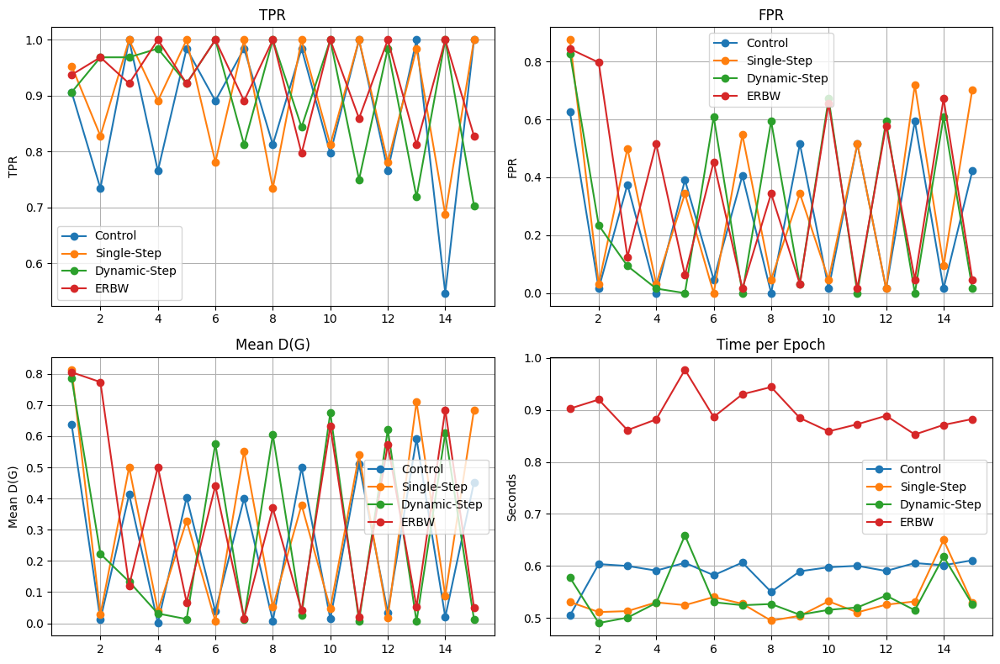

In [20]:
#!/usr/bin/env python3
"""
distill_real_vs_fake_schemes.py

Distillation of pretrained DCGAN Generator & Discriminator on MNIST.
Implements four sampling schemes (Control, Single-Step, Dynamic-Step, ERBW),
starts from pretrained weights, alternates D and G training per epoch,
tracks TPR, FPR on real vs. fake batches, mean D(G(z)), and training time,
saves model weights after each epoch as {D/G}_distill_{sampling_strategy}_{epoch}.pth,
and at end computes KL divergence between D(x) and D(G(z)) score distributions.
"""
import os
import random
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.backends.cudnn as cudnn
import torchvision.datasets as dset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
from collections import OrderedDict
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kurtosis

# ------------------- Config & Hyperparams -------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cudnn.benchmark = True
random.seed(2025)
torch.manual_seed(2025)

nz, ngf, ndf, nc = 100, 64, 64, 1
weights_dir = './weights'  # directory to save weight snapshots
os.makedirs(weights_dir, exist_ok=True)

epochs = 15
D_steps = 3
G_steps = 1
batch_size = 64
# dynamic and ERBW params
target_kurtosis = 1.0

# --------------------- Model Definitions ---------------------
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False), nn.BatchNorm2d(ngf*8), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*4), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*2), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*2, ngf,   4, 2, 1, bias=False), nn.BatchNorm2d(ngf),   nn.ReLU(True),
            nn.ConvTranspose2d(ngf,   nc,    1, 1, 0, bias=False), nn.Tanh()
        )
    def forward(self, z):
        return self.main(z)

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False), nn.LeakyReLU(0.2, True),
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf*2), nn.LeakyReLU(0.2, True),
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf*4), nn.LeakyReLU(0.2, True),
            nn.Conv2d(ndf*4, 1,      4, 1, 0, bias=False), nn.Sigmoid()
        )
    def forward(self, x):
        return self.main(x).view(-1)

# --------------------- Load pretrained -----------------------
netG0 = Generator().to(device)
netG0.load_state_dict(torch.load(os.path.join(weights_dir, 'netG_epoch_99.pth'), map_location=device))
netD0 = Discriminator().to(device)
netD0.load_state_dict(torch.load(os.path.join(weights_dir, 'netD_epoch_99.pth'), map_location=device))

# ----------------------- DataLoader --------------------------
transform = transforms.Compose([
    transforms.Resize(32), transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))
])
real_ds = dset.MNIST('./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_ds, batch_size=batch_size, shuffle=True)

raw_transform = transforms.Compose([
    transforms.Resize(32), transforms.ToTensor()
])
raw_ds = dset.MNIST('./data', train=True, download=True, transform=raw_transform)
raw_imgs = torch.stack([raw_ds[i][0] for i in range(len(raw_ds))]).to(device)

# ------------------ Sampling Schemes ------------------------
def train_control(G, D):
    optD = torch.optim.Adam(D.parameters(), lr=5e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss()
    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz,1,1,device=device))
    lossD = crit(D(real), torch.ones_like(real[:,0,0,0])) + \
            crit(D(fake.detach()), torch.zeros_like(real[:,0,0,0]))
    optD.zero_grad(); lossD.backward(); optD.step()
    fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
    lossG = crit(D(fake2), torch.ones_like(real[:,0,0,0]))
    optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

def train_single_step(G, D, real_ratio=0.7):
    optD = torch.optim.Adam(D.parameters(), lr=5e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz,1,1,device=device))
    outR, outF = D(real), D(fake.detach())
    lossD = (crit(outR, torch.ones_like(outR))*real_ratio).mean() + \
            (crit(outF, torch.zeros_like(outF))*(1-real_ratio)).mean()
    optD.zero_grad(); lossD.backward(); optD.step()
    fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
    lossG = crit(D(fake2), torch.ones_like(outR)).mean()
    optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

def train_dynamic_step(G, D, target_k=target_kurtosis):
    optD = torch.optim.Adam(D.parameters(), lr=5e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz,1,1,device=device))
    outR, outF = D(real), D(fake.detach())
    k = kurtosis(outF.detach().cpu().numpy())
    ratio = np.clip(0.5 + 0.5*abs(k-target_k), 0.2, 0.8)
    lossD = (crit(outR, torch.ones_like(outR))*ratio).mean() + \
            (crit(outF, torch.zeros_like(outF))*(1-ratio)).mean()
    optD.zero_grad(); lossD.backward(); optD.step()
    fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
    lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
    optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

class ERBWBuffer:
    def __init__(self, data): self.data=data.view(len(data),-1).cpu().numpy(); self.ts=np.zeros(len(data))
    def update(self, fake): idx=np.argmax(cosine_similarity(fake.detach().view(len(fake),-1).cpu().numpy(),self.data),axis=1); self.ts[idx]=self.ts.max()+1
    def weights(self, fake): idx=np.argmax(cosine_similarity(fake.detach().view(len(fake),-1).cpu().numpy(),self.data),axis=1); return F.softmax(torch.from_numpy(self.ts[idx]).float(),dim=0).to(fake.device)

def train_erbw(G, D, buf):
    optD = torch.optim.Adam(D.parameters(), lr=5e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz,1,1,device=device))
    buf.update(fake)
    w = buf.weights(fake)
    outR, outF_det = D(real), D(fake.detach())
    lossD = crit(outR, torch.ones_like(outR)).mean()*0.5 + (crit(outF_det, torch.zeros_like(outF_det))*w).mean()
    optD.zero_grad(); lossD.backward(); optD.step()
    fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
    lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
    optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

# ------------------- Main Distill Loop -------------------
buffer = ERBWBuffer(raw_imgs)
schemes = OrderedDict([
    ('Control',      train_control),
    ('Single-Step',  train_single_step),
    ('Dynamic-Step', train_dynamic_step),
    ('ERBW',         lambda G,D: train_erbw(G,D,buffer))
])
models = {}
for name in schemes:
    G = Generator().to(device); G.load_state_dict(netG0.state_dict())
    D = Discriminator().to(device); D.load_state_dict(netD0.state_dict())
    models[name] = {'G':G,'D':D}

# storage
metrics = {name:{'tpr':[],'fpr':[],'mean_fake':[],'time':[]} for name in schemes}
epochs_list = range(1, epochs+1)
for ep in epochs_list:
    print(f"\nEpoch {ep}/{epochs}")
    real_iter = iter(real_loader)
    for name, fn in schemes.items():
        G, D = models[name]['G'], models[name]['D']
        start = time.time(); G, D = fn(G, D); elapsed = time.time()-start
        realb = next(real_iter)[0].to(device)
        fakeb = G(torch.randn(batch_size, nz,1,1,device=device))
        with torch.no_grad(): r = D(realb); f = D(fakeb)
        tpr = (r>0.5).float().mean().item()
        fpr = (f>0.5).float().mean().item()
        mf = f.mean().item()
        metrics[name]['tpr'].append(tpr)
        metrics[name]['fpr'].append(fpr)
        metrics[name]['mean_fake'].append(mf)
        metrics[name]['time'].append(elapsed)
        print(f"{name}: TPR={tpr:.3f}, FPR={fpr:.3f}, MeanD(G)={mf:.3f}, Time={elapsed:.1f}s")
        # Save weights

        torch.save(D.state_dict(), os.path.join(weights_dir, f"D_distill_{name}_{ep}.pth"))
        torch.save(G.state_dict(), os.path.join(weights_dir, f"G_distill_{name}_{ep}.pth"))

# -------------------- Plot Summaries ------------------------
plt.figure(figsize=(12,8))
plt.subplot(2,2,1)
for name in schemes: plt.plot(epochs_list, metrics[name]['tpr'], '-o', label=name)
plt.title('TPR'); plt.ylabel('TPR'); plt.legend(); plt.grid()
plt.subplot(2,2,2)
for name in schemes: plt.plot(epochs_list, metrics[name]['fpr'], '-o', label=name)
plt.title('FPR'); plt.ylabel('FPR'); plt.legend(); plt.grid()
plt.subplot(2,2,3)
for name in schemes: plt.plot(epochs_list, metrics[name]['mean_fake'], '-o', label=name)
plt.title('Mean D(G)'); plt.ylabel('Mean D(G)'); plt.legend(); plt.grid()
plt.subplot(2,2,4)
for name in schemes: plt.plot(epochs_list, metrics[name]['time'], '-o', label=name)
plt.title('Time per Epoch'); plt.ylabel('Seconds'); plt.legend(); plt.grid()
plt.tight_layout()
plt.show()


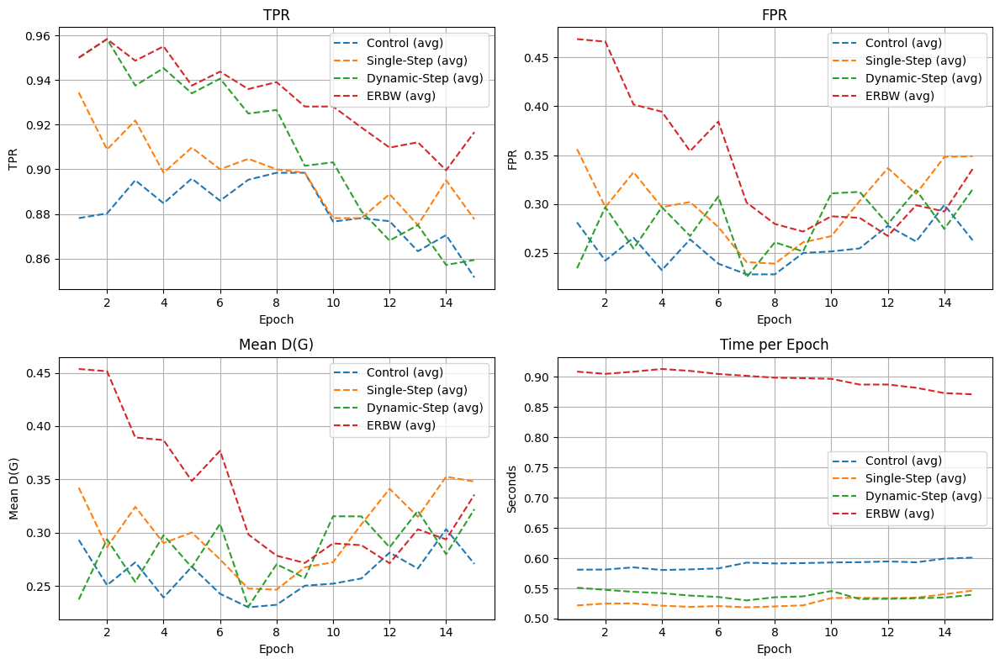

In [23]:
# -------------------- Plot Summaries w/ Rolling Average ------------------------
window_size = 10

plt.figure(figsize=(12,8))

# TPR
plt.subplot(2,2,1)
for name in schemes:
    raw = pd.Series(metrics[name]['tpr'], index=epochs_list)
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(epochs_list, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('TPR')
plt.xlabel('Epoch'); plt.ylabel('TPR')
plt.legend(); plt.grid()

# FPR
plt.subplot(2,2,2)
for name in schemes:
    raw = pd.Series(metrics[name]['fpr'], index=epochs_list)
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(epochs_list, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('FPR')
plt.xlabel('Epoch'); plt.ylabel('FPR')
plt.legend(); plt.grid()

# Mean D(G)
plt.subplot(2,2,3)
for name in schemes:
    raw = pd.Series(metrics[name]['mean_fake'], index=epochs_list)
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(epochs_list, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('Mean D(G)')
plt.xlabel('Epoch'); plt.ylabel('Mean D(G)')
plt.legend(); plt.grid()

# Time per Epoch
plt.subplot(2,2,4)
for name in schemes:
    raw = pd.Series(metrics[name]['time'], index=epochs_list)
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(epochs_list, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('Time per Epoch')
plt.xlabel('Epoch'); plt.ylabel('Seconds')
plt.legend(); plt.grid()

plt.tight_layout()
plt.show()



Generation 1/20
Control: TPR=0.922, MeanD(G)=0.215, FPR=0.172, Time=1.7s
Single-Step: TPR=0.891, MeanD(G)=0.361, FPR=0.359, Time=1.8s
Dynamic-Step: TPR=1.000, MeanD(G)=0.614, FPR=0.594, Time=1.9s
ERBW: TPR=0.969, MeanD(G)=0.902, FPR=0.922, Time=3.6s

Generation 2/20
Control: TPR=1.000, MeanD(G)=0.089, FPR=0.094, Time=1.7s
Single-Step: TPR=0.953, MeanD(G)=0.243, FPR=0.203, Time=1.9s
Dynamic-Step: TPR=0.984, MeanD(G)=0.245, FPR=0.219, Time=2.0s
ERBW: TPR=0.984, MeanD(G)=0.902, FPR=0.906, Time=3.6s

Generation 3/20
Control: TPR=0.984, MeanD(G)=0.109, FPR=0.109, Time=1.7s
Single-Step: TPR=1.000, MeanD(G)=0.277, FPR=0.266, Time=1.7s
Dynamic-Step: TPR=1.000, MeanD(G)=0.317, FPR=0.297, Time=1.7s
ERBW: TPR=1.000, MeanD(G)=0.780, FPR=0.797, Time=3.6s

Generation 4/20
Control: TPR=0.953, MeanD(G)=0.049, FPR=0.031, Time=1.8s
Single-Step: TPR=1.000, MeanD(G)=0.196, FPR=0.172, Time=2.2s
Dynamic-Step: TPR=0.969, MeanD(G)=0.147, FPR=0.094, Time=1.9s
ERBW: TPR=1.000, MeanD(G)=0.611, FPR=0.609, Time=3

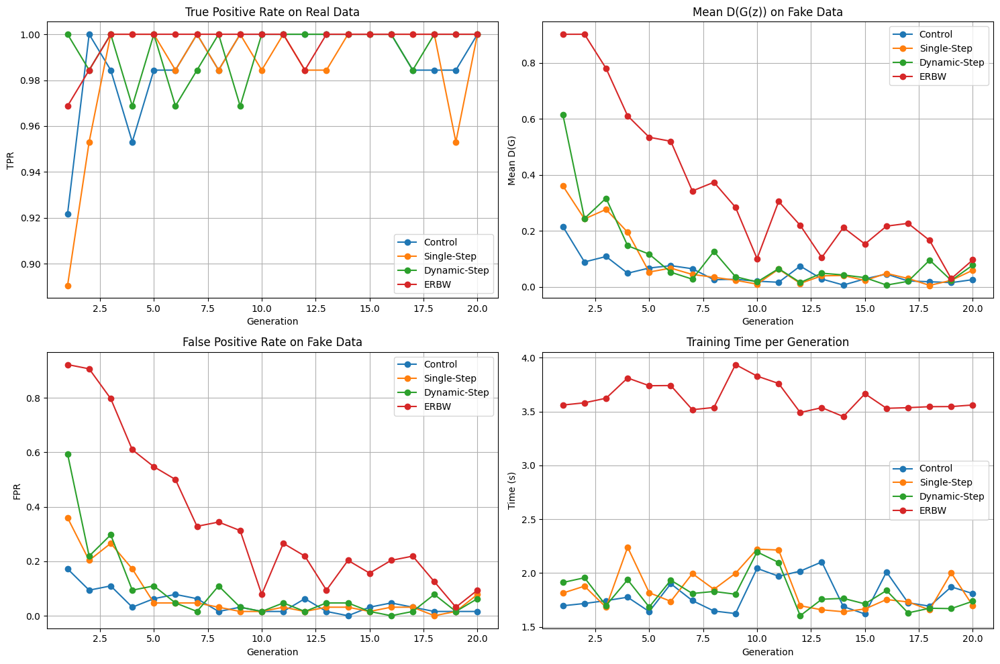

In [14]:
### coevolve_real_vs_fake_schemes.py

"""
Coevolution of pretrained DCGAN Generator & Discriminator on MNIST.
Implements four sampling schemes (Control, Single-Step, Dynamic-Step, ERBW),
starts from pretrained weights, alternates D and G training per generation,
tracks True Positive Rate (TPR) on real data, False Positive Rate (FPR) on fake data,
mean D(G(z)) on fake data, and training time,
prints per-generation summaries and plots final metrics.
"""
import os
import random
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.backends.cudnn as cudnn
import torchvision.datasets as dset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from collections import OrderedDict
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kurtosis

# ------------------- Config & Hyperparams -------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cudnn.benchmark = True
random.seed(2025)
torch.manual_seed(2025)

nz, ngf, ndf, nc = 100, 64, 64, 1
weights_dir = './weights'  # netG_epoch_99.pth & netD_epoch_99.pth

generations = 100
D_steps = 3
G_steps = 1
batch_size = 64
# ERBW and dynamic step params
target_kurtosis = 1.0

# --------------------- Model Definitions ---------------------
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False), nn.BatchNorm2d(ngf*8), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*4), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*2), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*2, ngf,   4, 2, 1, bias=False), nn.BatchNorm2d(ngf),   nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 1, 1, 0, bias=False), nn.Tanh()
        )
    def forward(self, z):
        out = self.main(z)
        out = out[:, :, :28, :28]  # center-crop to 28×28
        return F.interpolate(out, size=(32,32), mode='bilinear', align_corners=False)

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf*2), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf*4), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*4, 1, 4, 1, 0, bias=False), nn.Sigmoid()
        )
    def forward(self, x):
        return self.main(x).view(-1)

# --------------------- Load pretrained -----------------------
netG0 = Generator().to(device)
netG0.load_state_dict(torch.load(os.path.join(weights_dir,'netG_epoch_99.pth'), map_location=device))
netD0 = Discriminator().to(device)
netD0.load_state_dict(torch.load(os.path.join(weights_dir,'netD_epoch_99.pth'), map_location=device))

# ----------------------- DataLoader --------------------------
transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
real_ds = dset.MNIST('./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_ds, batch_size=batch_size, shuffle=True)
# raw images for ERBW buffer (unnormalized)
raw_transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor()
])
raw_ds = dset.MNIST('./data', train=True, download=True, transform=raw_transform)
raw_imgs = torch.stack([raw_ds[i][0] for i in range(len(raw_ds))]).to(device)

# ------------------ Sampling Schemes ------------------------

def train_control(G, D):
    optD = torch.optim.Adam(D.parameters(), lr=7e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss()
    # Discriminator step
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        lossD = crit(outR, torch.ones_like(outR)) + crit(outF, torch.zeros_like(outF))
        optD.zero_grad(); lossD.backward(); optD.step()
    # Generator step
    for _ in range(G_steps):
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outF = D(fake)
        lossG = crit(outF, torch.ones_like(outF))
        optG.zero_grad(); lossG.backward(); optG.step()
    return G, D


def train_single_step(G, D, real_ratio=0.7):
    optD = torch.optim.Adam(D.parameters(), lr=7e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        wR, wF = real_ratio, 1-real_ratio
        lossD = (crit(outR, torch.ones_like(outR)) * wR).mean() + \
                (crit(outF, torch.zeros_like(outF)) * wF).mean()
        optD.zero_grad(); lossD.backward(); optD.step()
    for _ in range(G_steps):
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outF = D(fake)
        lossG = crit(outF, torch.ones_like(outF)).mean()
        optG.zero_grad(); lossG.backward(); optG.step()
    return G, D


def train_dynamic_step(G, D, target_k=target_kurtosis):
    optD = torch.optim.Adam(D.parameters(), lr=7e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        k = kurtosis(outF.detach().cpu().numpy())
        ratio = np.clip(0.5 + 0.5 * abs(k - target_k), 0.2, 0.8)
        wR, wF = ratio, 1-ratio
        lossD = (crit(outR, torch.ones_like(outR)) * wR).mean() + \
                (crit(outF, torch.zeros_like(outF)) * wF).mean()
        optD.zero_grad(); lossD.backward(); optD.step()
    for _ in range(G_steps):
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outF = D(fake)
        lossG = nn.BCELoss()(outF, torch.ones_like(outF))
        optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

class ERBWBuffer:
    def __init__(self, data):
        self.data = data.view(len(data), -1).cpu().numpy()
        self.ts = np.zeros(len(data))
    def update(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx = np.argmax(cosine_similarity(flat, self.data), axis=1)
        self.ts[idx] = self.ts.max() + 1
    def weights(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx = np.argmax(cosine_similarity(flat, self.data), axis=1)
        w = F.softmax(torch.from_numpy(self.ts[idx]).float(), dim=0)
        return w.to(fake.device)

def train_erbw(G, D, buf):
    optD = torch.optim.Adam(D.parameters(), lr=7e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        buf.update(fake)
        w = buf.weights(fake)
        outR, outF = D(real), D(fake.detach())
        lossD_real = crit(outR, torch.ones_like(outR)).mean()
        lossD_fake = (crit(outF, torch.zeros_like(outF)) * w).mean()
        optD.zero_grad(); (lossD_real + lossD_fake).backward(); optD.step()
    for _ in range(G_steps):
        fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
        outF2 = D(fake2)
        lossG = nn.BCELoss()(outF2, torch.ones_like(outF2))
        optG.zero_grad(); lossG.backward(); optG.step()
    return G, D

# ------------------- Main Coevolution Loop -------------------
buffer = ERBWBuffer(raw_imgs)
schemes = OrderedDict([
    ('Control',      lambda g,d: train_control(g,d)),
    ('Single-Step',  lambda g,d: train_single_step(g,d,0.7)),
    ('Dynamic-Step', lambda g,d: train_dynamic_step(g,d)),
    ('ERBW',         lambda g,d: train_erbw(g,d,buffer))
])

# initialize models
models = {name: {'G':Generator().to(device), 'D':Discriminator().to(device)} for name in schemes}
for m in models.values():
    m['G'].load_state_dict(netG0.state_dict())
    m['D'].load_state_dict(netD0.state_dict())

# metrics storage
gens = np.arange(1, generations+1)
metrics = {name: {'tpr': [], 'mean_fake': [], 'fpr': [], 'time': []} for name in schemes}

for gen in range(generations):
    print(f"\nGeneration {gen+1}/{generations}")
    real_iter = iter(real_loader)
    for name, fn in schemes.items():
        G, D = models[name]['G'], models[name]['D']
        start = time.time()
        G, D = fn(G, D)
        elapsed = time.time() - start
        real = next(real_iter)[0].to(device)
        with torch.no_grad():
            r = D(real)
            fake_batch = G(torch.randn(batch_size, nz,1,1,device=device))
            f = D(fake_batch)
        tpr = (r > 0.5).float().mean().item()
        mean_fake = f.mean().item()
        fpr = (f > 0.5).float().mean().item()
        metrics[name]['tpr'].append(tpr)
        metrics[name]['mean_fake'].append(mean_fake)
        metrics[name]['fpr'].append(fpr)
        metrics[name]['time'].append(elapsed)
        print(f"{name}: TPR={tpr:.3f}, MeanD(G)={mean_fake:.3f}, FPR={fpr:.3f}, Time={elapsed:.1f}s")

        torch.save(D.state_dict(), os.path.join(weights_dir, f"D_coevolve_{name}_{gen+1}.pth"))
        torch.save(G.state_dict(), os.path.join(weights_dir, f"G_coevolve_{name}_{gen+1}.pth"))


# -------------------- Plot Summaries ------------------------
plt.figure(figsize=(15,10))
plt.subplot(2,2,1)
for name in schemes: plt.plot(gens, metrics[name]['tpr'], marker='o', label=name)
plt.title('True Positive Rate on Real Data')
plt.xlabel('Generation'); plt.ylabel('TPR'); plt.legend(); plt.grid()

plt.subplot(2,2,2)
for name in schemes: plt.plot(gens, metrics[name]['fpr'], marker='o', label=name)
plt.title('False Positive Rate on Fake Data')
plt.xlabel('Generation'); plt.ylabel('FPR'); plt.legend(); plt.grid()

plt.subplot(2,2,3)
for name in schemes: plt.plot(gens, metrics[name]['mean_fake'], marker='o', label=name)
plt.title('Mean D(G(z)) on Fake Data')
plt.xlabel('Generation'); plt.ylabel('Mean D(G)'); plt.legend(); plt.grid()

plt.subplot(2,2,4)
for name in schemes: plt.plot(gens, metrics[name]['time'], marker='o', label=name)
plt.title('Training Time per Generation')
plt.xlabel('Generation'); plt.ylabel('Time (s)'); plt.legend(); plt.grid()

plt.tight_layout()
plt.show()

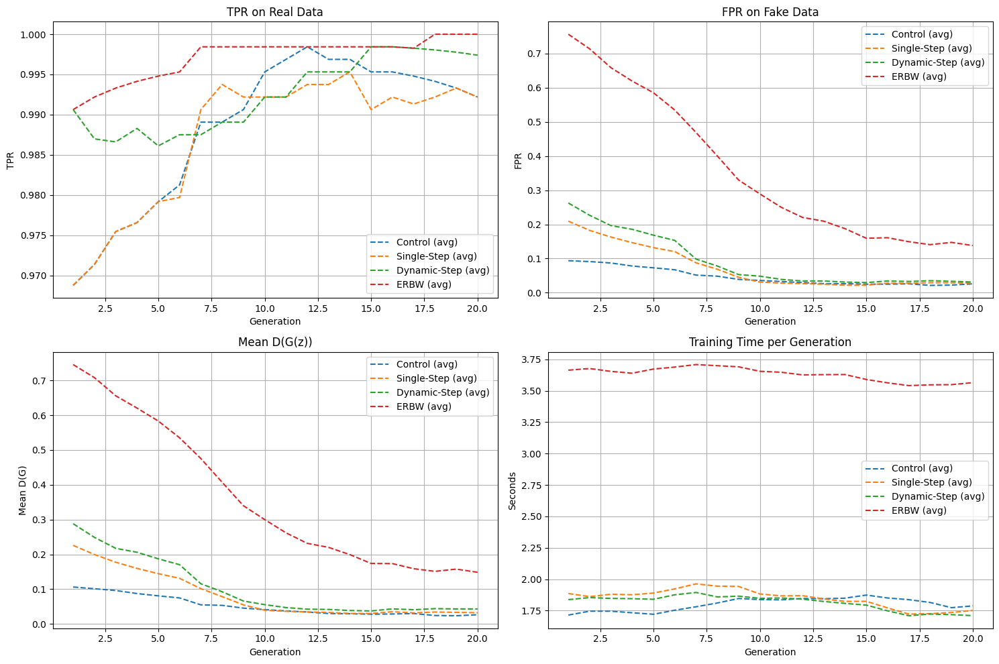

In [17]:
# -------------------- Plot Summaries w/ Rolling Average ------------------------
window_size = 5

plt.figure(figsize=(15,10))

# True Positive Rate
plt.subplot(2,2,1)
for name in schemes:
    raw = pd.Series(metrics[name]['tpr'])
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(gens, smooth,   linestyle='--', label=f"{name} (avg)")
plt.title('TPR on Real Data')
plt.xlabel('Generation'); plt.ylabel('TPR')
plt.legend(); plt.grid()

# False Positive Rate
plt.subplot(2,2,2)
for name in schemes:
    raw = pd.Series(metrics[name]['fpr'])
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(gens, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('FPR on Fake Data')
plt.xlabel('Generation'); plt.ylabel('FPR')
plt.legend(); plt.grid()

# Mean D(G(z))
plt.subplot(2,2,3)
for name in schemes:
    raw = pd.Series(metrics[name]['mean_fake'])
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(gens, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('Mean D(G(z))')
plt.xlabel('Generation'); plt.ylabel('Mean D(G)')
plt.legend(); plt.grid()

# Training time
plt.subplot(2,2,4)
for name in schemes:
    raw = pd.Series(metrics[name]['time'])
    smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
    plt.plot(gens, smooth, linestyle='--', label=f"{name} (avg)")
plt.title('Training Time per Generation')
plt.xlabel('Generation'); plt.ylabel('Seconds')
plt.legend(); plt.grid()

plt.tight_layout()
plt.show()


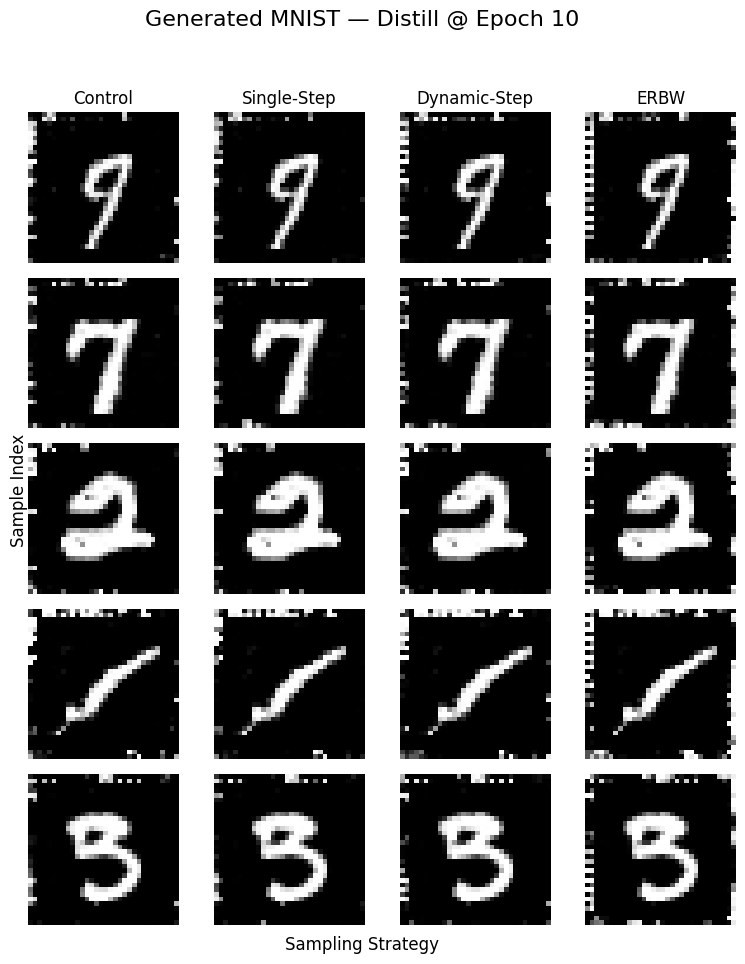

In [4]:
import os
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

# device & latent dim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
nz = 100

# the four sampling strategies
STRATEGIES = ['Control', 'Single-Step', 'Dynamic-Step', 'ERBW']

# Generator architecture (must match your training scripts)
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, 64*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64*8), nn.ReLU(True),
            nn.ConvTranspose2d(64*8, 64*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*4), nn.ReLU(True),
            nn.ConvTranspose2d(64*4, 64*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*2), nn.ReLU(True),
            nn.ConvTranspose2d(64*2, 64,   4, 2, 1, bias=False),
            nn.BatchNorm2d(64),   nn.ReLU(True),
            nn.ConvTranspose2d(64,   1,    1, 1, 0, bias=False),
            nn.Tanh()
        )
    def forward(self, z):
        return self.main(z)

def load_generator(experiment, strategy, epoch, weights_dir='./weights'):
    """
    Load G_{experiment}_{strategy}_{epoch}.pth from weights_dir.
    experiment: 'distill' or 'coevolve'
    strategy: one of STRATEGIES
    """
    G = Generator().to(device)
    fname = f"G_{experiment}_{strategy}_{epoch}.pth"
    path = os.path.join(weights_dir, fname)
    if not os.path.isfile(path):
        raise FileNotFoundError(f"Cannot find {path}")
    G.load_state_dict(torch.load(path, map_location=device))
    G.eval()
    return G

def demo(experiment='distill', epoch=5, num_samples=5, weights_dir='./weights'):
    """
    Produce a num_samples × len(STRATEGIES) grid of generated digits.
    demo(experiment, epoch)
    """
    noise = torch.randn(num_samples, nz, 1, 1, device=device)
    fig, axes = plt.subplots(num_samples, len(STRATEGIES),
                             figsize=(len(STRATEGIES)*2, num_samples*2))

    for col, strat in enumerate(STRATEGIES):
        G = load_generator(experiment, strat, epoch, weights_dir)
        with torch.no_grad():
            fake_imgs = G(noise).cpu().squeeze().numpy()  # shape: [num_samples, 28,28]

        for row in range(num_samples):
            ax = axes[row, col]
            img = (fake_imgs[row] + 1.0) / 2.0  # denormalize from [-1,1] → [0,1]
            ax.imshow(img, cmap='gray', vmin=0, vmax=1)
            ax.axis('off')
            if col == 0:
                ax.set_ylabel(f"Sample {row+1}", fontsize=10)
        axes[0, col].set_title(strat, fontsize=12)

    fig.suptitle(f"Generated MNIST — {experiment.capitalize()} @ Epoch {epoch}", fontsize=16)
    fig.text(0.5, 0.04, 'Sampling Strategy', ha='center', fontsize=12)
    fig.text(0.06, 0.5, 'Sample Index', va='center', rotation='vertical', fontsize=12)
    plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
    plt.show()

# Example call:
demo(experiment="distill", epoch=10)


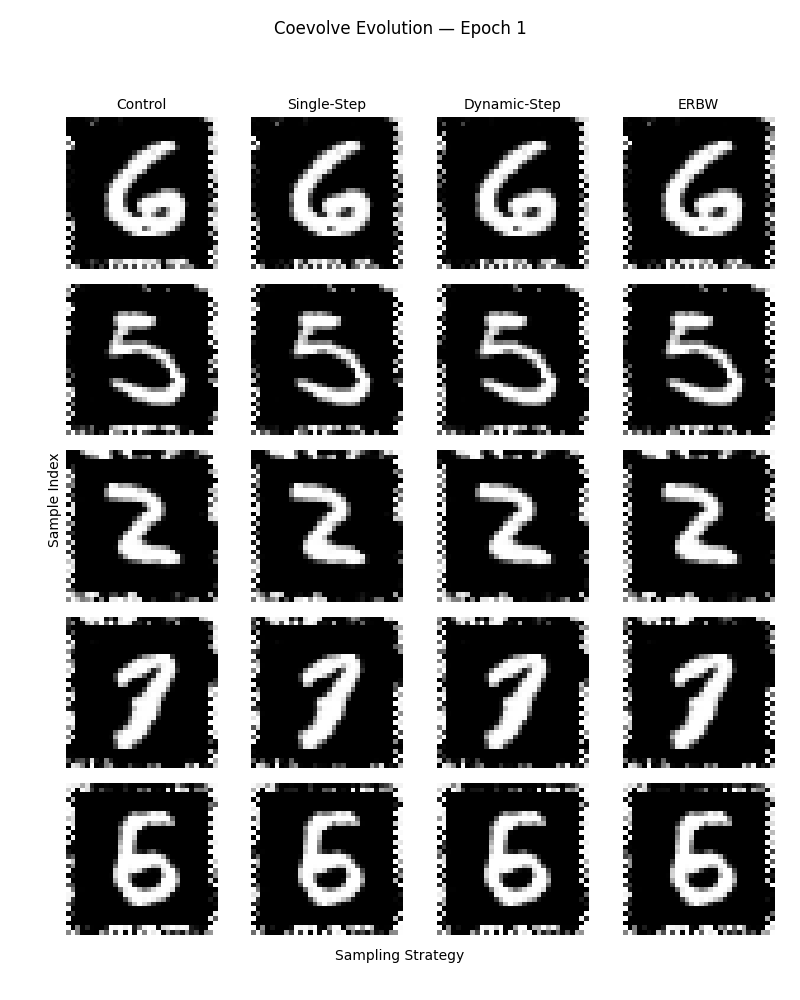

In [25]:
import imageio
import numpy as np
from IPython.display import Image, display
import matplotlib.pyplot as plt
import torch

def animate_epochs(experiment, epochs, num_samples=5, weights_dir='./weights',
                   fps=1, output_path='evolution.gif'):
    """
    For each epoch in `epochs`, load the 4 generators for that experiment,
    sample `num_samples` digits, assemble a grid, capture it, and
    write out an animated GIF evolving over time.
    Displays the GIF inline.
    """
    # fixed noise so we see the same latent vectors over time
    noise = torch.randn(num_samples, nz, 1, 1, device=device)
    frames = []

    for ep in epochs:
        # build the grid
        fig, axes = plt.subplots(num_samples, len(STRATEGIES),
                                 figsize=(len(STRATEGIES)*2, num_samples*2))
        for col, strat in enumerate(STRATEGIES):
            G = load_generator(experiment, strat, ep, weights_dir)
            with torch.no_grad():
                fake = G(noise).cpu().squeeze().numpy()  # (num_samples, H, W)

            for row in range(num_samples):
                ax = axes[row, col]
                img = (fake[row] + 1.0) / 2.0  # denormalize from [-1,1] to [0,1]
                ax.imshow(img, cmap='gray', vmin=0, vmax=1)
                ax.axis('off')
                if col == 0:
                    ax.set_ylabel(f"Sample {row+1}", fontsize=8)
            axes[0, col].set_title(strat, fontsize=10)

        fig.suptitle(f"{experiment.capitalize()} Evolution — Epoch {ep}", fontsize=12)
        fig.text(0.5, 0.04, 'Sampling Strategy', ha='center', fontsize=10)
        fig.text(0.06, 0.5, 'Sample Index', va='center', rotation='vertical', fontsize=10)
        plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])

        # render to buffer (RGBA) then convert to RGB
        buf, (w, h) = fig.canvas.print_to_buffer()
        arr = np.frombuffer(buf, dtype=np.uint8).reshape((h, w, 4))
        frames.append(arr[:, :, :3])
        plt.close(fig)

    # save and display
    imageio.mimsave(output_path, frames, fps=fps)
    display(Image(filename=output_path))
    return output_path

# Example usage in your notebook:
gif_path = animate_epochs(experiment='coevolve', epochs=range(1, 200), num_samples=5, fps=15)